In [8]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [9]:
# Global parameters
total_years = 20 # this will be calculated based on study start and end dates
# Adoption model differential eq Parameters
dt = 1/12  # time step in years (monthly)
time = np.arange(0, total_years, dt)
n = len(time)

In [10]:

nc_per_year = 10 #this value will be an input table from the characterizer #these need to be per competition group and building type
nc = nc_per_year * dt 
nc_arr = np.full(n, nc)  # Create an array for plotting this is the new construction per time step
# initialize an array of cumulative annual totals for nc
nc_cumulative_annual = np.zeros(n)
nc = nc_per_year * dt 
nc_arr = np.full(n, nc)
nc_cumulative_annual = np.cumsum(nc_arr)

# Demolition 
demo_per_year = 10 #this value will be an input table from the characterizer
demo = demo_per_year * dt 
demo_arr = np.full(n, demo)  # Create an array for plotting this is the demo per time step
# initialize an array of cumulative annual totals for nc
demo_cumulative_annual = np.zeros(n)
demo = demo_per_year * dt 
demo_arr = np.full(n, demo)
demo_cumulative_annual = np.cumsum(demo_arr)

# Renovation
reno_per_year = 10 #this value will be an input table from the characterizer
reno = reno_per_year * dt 
reno_arr = np.full(n, reno)  # Create an array for plotting this is the demo per time step
# initialize an array of cumulative annual totals for nc
reno_cumulative_annual = np.zeros(n)
reno = reno_per_year * dt 
reno_arr = np.full(n, reno)
reno_cumulative_annual = np.cumsum(reno_arr)

In [11]:
#these retirement rates will come from the condition input sheet for each condition (can they be unique to each condition?)
#is er and Add on a calculable value?
rob_retirement_rate = 1
ret_er_retirement_rate = 0.02
ret_add_on_retirement_rate = 0.02

In [12]:
df = pd.read_pickle("../market_inputs/df_yrs.pkl")

#######################
### feature request ###
#######################
# Create competition allocation based on PCT test for efficient measures


# Define a function to extract the size
def extract_eff_level(description):
    if 'baseline' in description:
        return 'baseline'
    elif 'existing' in description:
        return 'existing'
    elif 'efficient' in description:
        return 'efficient'
    elif 'top10' in description:
        return 'top10' #this change is made because top10 is considered efficient in refrigeration for now just holding to get number right
    else:
        return 'Unknown'

# Apply the function to the 'Description' column to create the new 'Size' column
df['efficiency_level'] = df['condition_name'].apply(extract_eff_level)
df

,condition_name,competition_group,subgroup,electric_utility,gas_utility,building_type,measure_life_(yrs)_x,intial_count,condition,market,...,SCT_cost,SCT_benefit,SCT_BCR,RIM_cost,RIM_benefit,RIM_BCR,PCT_cost,PCT_benefit,PCT_BCR,efficiency_level
0,refrigerator_electricity_existing_residential,refrigeration,full_size,test_utility_1,test_utility_1,single_family,10.0,12500.0,refrigerator_electricity_existing_residential,ROB,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,existing
1,refrigerator_electricity_existing_residential,refrigeration,full_size,test_utility_1,test_utility_2,single_family,10.0,25000.0,refrigerator_electricity_existing_residential,ROB,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,existing
2,refrigerator_electricity_existing_residential,refrigeration,full_size,test_utility_2,test_utility_2,single_family,10.0,68750.0,refrigerator_electricity_existing_residential,ROB,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,existing
3,refrigerator_electricity_existing_residential,refrigeration,full_size,test_utility_1,none,single_family,10.0,12500.0,refrigerator_electricity_existing_residential,ROB,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,existing
4,refrigerator_electricity_existing_residential,refrigeration,full_size,test_utility_2,none,single_family,10.0,13750.0,refrigerator_electricity_existing_residential,ROB,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,existing
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
415,insulation_natural_gas_efficient_residential,whole_home,none,test_utility_2,test_utility_2,multi_family_li,30.0,350.0,insulation_natural_gas_efficient_residential,REMAINING,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,efficient
416,insulation_natural_gas_efficient_residential,whole_home,none,test_utility_1,none,multi_family_li,30.0,125.0,insulation_natural_gas_efficient_residential,REMAINING,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,efficient
417,insulation_natural_gas_efficient_residential,whole_home,none,test_utility_2,none,multi_family_li,30.0,125.0,insulation_natural_gas_efficient_residential,REMAINING,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,efficient
418,insulation_natural_gas_efficient_residential,whole_home,none,none,test_utility_1,multi_family_li,30.0,125.0,insulation_natural_gas_efficient_residential,REMAINING,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,efficient


In [13]:
def baseline_eq_dynamic(substocks, m, retirement_rate, df_filtered=None):
    """
    Dynamic baseline equation that works with variable substocks.
    
    Parameters:
    -----------
    substocks : dict
        Dictionary with efficiency levels as keys and stock values as values
        e.g., {'baseline': 100, 'efficient': 50, 'top10': 25}
    m : float
        Total stock size
    retirement_rate : float
        Retirement rate for this market
    df_filtered : pd.DataFrame
        Filtered dataframe (not used in baseline, but kept for consistency)
    
    Returns:
    --------
    dict
        Dictionary with efficiency levels as keys and their dStock/dt values
    """
    Tech_Value = 0  # Baseline scenario: no adoption of efficient measures
    Retirement_Flow = m * retirement_rate
    
    # Initialize return dictionary
    d_substocks = {}
    
    # Calculate flows for each substock
    for level, stock_value in substocks.items():
        # All retirements stay at their current level in baseline scenario
        d_substocks[level] = -stock_value * retirement_rate
    
    # Add the retirement flow back to the same levels proportionally
    if m > 0:
        for level, stock_value in substocks.items():
            proportion = stock_value / m
            d_substocks[level] += Retirement_Flow * proportion
    
    return d_substocks


def tech_eq_dynamic(substocks, m, retirement_rate, df_filtered=None):
    """
    Dynamic technical potential equation that works with variable substocks.
    All retirements go to the highest efficiency level available.
    """
    Tech_Value = 1  # 100% adoption of best available technology
    Retirement_Flow = m * retirement_rate
    
    # Initialize return dictionary
    d_substocks = {}
    
    # Determine the highest efficiency level available
    efficiency_hierarchy = ['below_baseline', 'baseline', 'efficient', 'top10']
    available_levels = [level for level in efficiency_hierarchy if level in substocks]
    
    if not available_levels:
        return d_substocks
    
    highest_level = available_levels[-1]  # Get the highest available level
    
    # Calculate flows for each substock
    for level in available_levels:
        # All substocks lose stock due to retirement
        d_substocks[level] = -substocks[level] * retirement_rate
        
        # Only the highest level gains from retirements
        if level == highest_level:
            d_substocks[level] += Retirement_Flow * Tech_Value
    
    return d_substocks


def competition_eq_dynamic(substocks, m, retirement_rate, df_filtered=None):
    """
    Dynamic competition equation that works with variable substocks.
    Uses PCT_BCR to allocate between efficient and top10 if both exist.
    """
    # Initialize return dictionary
    d_substocks = {}
    Retirement_Flow = m * retirement_rate
    
    # Determine which efficiency levels are available
    has_top10 = 'top10' in substocks
    has_efficient = 'efficient' in substocks
    
    # Calculate Tech_Value based on available data
    Tech_Value = 0.0
    if has_top10 and has_efficient and df_filtered is not None and len(df_filtered) > 0:
        top10_bcr = df_filtered.loc[df_filtered['efficiency_level'] == 'top10', 'PCT_BCR'].sum()
        efficient_bcr = df_filtered.loc[df_filtered['efficiency_level'] == 'efficient', 'PCT_BCR'].sum()
        
        total_bcr = top10_bcr + efficient_bcr
        if total_bcr > 0:
            Tech_Value = top10_bcr / total_bcr
    elif has_top10:
        # If only top10 exists, all competitive flow goes there
        Tech_Value = 1.0
    elif has_efficient:
        # If only efficient exists, all competitive flow goes there
        Tech_Value = 0.0  # This means efficient gets 1-Tech_Value = 1.0
    
    # Calculate flows for each substock
    efficiency_hierarchy = ['below_baseline', 'baseline', 'efficient', 'top10']
    available_levels = [level for level in efficiency_hierarchy if level in substocks]
    
    # All substocks lose stock due to retirement
    for level in available_levels:
        d_substocks[level] = -substocks[level] * retirement_rate
    
    # Distribute retirement flow to efficient levels based on competition
    if has_top10 and has_efficient:
        # Split between top10 and efficient based on Tech_Value
        d_substocks['top10'] += Retirement_Flow * Tech_Value
        d_substocks['efficient'] += Retirement_Flow * (1 - Tech_Value)
    elif has_top10:
        # All goes to top10
        d_substocks['top10'] += Retirement_Flow
    elif has_efficient:
        # All goes to efficient
        d_substocks['efficient'] += Retirement_Flow
    elif 'baseline' in substocks:
        # If no efficient measures exist, flow goes to baseline
        d_substocks['baseline'] += Retirement_Flow
    
    return d_substocks

In [14]:
def run_adoption_model_dynamic(adoption_function, scenario_name='baseline'):
    """
    Run the adoption model with dynamic substock handling.
    Includes new construction, demolition, and renovation flows.
    """
    competition_groups = ['refrigeration', 'whole_home']
    electric_utility = ['test_utility_1', 'none', 'test_utility_2']
    gas_utility = ['test_utility_1', 'none', 'test_utility_2']
    building_type = ['multi_family', 'single_family', 'multi_family_li', 'single_family_li']

    results = []

    for cg in competition_groups:
        for eu in electric_utility:
            for gu in gas_utility:
                for bt in building_type:
                    df_filtered = df[
                        (df['competition_group'] == cg) &
                        (df['electric_utility'] == eu) &
                        (df['gas_utility'] == gu) &
                        (df['building_type'] == bt)
                    ]
                    
                    # Skip if no data for this combination
                    if len(df_filtered) == 0:
                        continue
                    
                    # Map efficiency_level names (handle 'existing' -> 'below_baseline')
                    level_mapping = {'existing': 'below_baseline', 'baseline': 'baseline', 
                                   'efficient': 'efficient', 'top10': 'top10'}
                    
                    # Initialize market stocks
                    total_stock = np.zeros(n)
                    market_stocks = {
                        'RET_ER': {},
                        'REMAINING': {},
                        'ROB': {}
                    }
                    
                    # For each market, create only the substocks that exist
                    for market in ['RET_ER', 'REMAINING', 'ROB']:
                        market_df = df_filtered[df_filtered['market'] == market]
                        market_levels = market_df['efficiency_level'].unique()
                        
                        for eff_level in market_levels:
                            mapped_level = level_mapping.get(eff_level, eff_level)
                            market_stocks[market][mapped_level] = np.zeros(n)
                            
                            # Set initial value at t=0
                            initial_count = market_df.loc[
                                market_df['efficiency_level'] == eff_level, 'count'
                            ].sum()
                            market_stocks[market][mapped_level][0] = initial_count
                    
                    # Calculate total stocks for each market
                    ret_er_stock = np.zeros(n)
                    remaining_stock = np.zeros(n)
                    rob_stock = np.zeros(n)
                    
                    ret_er_stock[0] = sum(market_stocks['RET_ER'][level][0] 
                                         for level in market_stocks['RET_ER'])
                    remaining_stock[0] = sum(market_stocks['REMAINING'][level][0] 
                                            for level in market_stocks['REMAINING'])
                    rob_stock[0] = sum(market_stocks['ROB'][level][0] 
                                      for level in market_stocks['ROB'])
                    total_stock[0] = ret_er_stock[0] + remaining_stock[0] + rob_stock[0]
                    
                    # Time stepping loop
                    for t in range(1, n):
                        total_stock[t] = total_stock[t-1] + nc - demo
                        
                        # --- Process RET_ER Market ---
                        ret_er_substocks = {level: market_stocks['RET_ER'][level][t-1] 
                                           for level in market_stocks['RET_ER']}
                        d_ret_er = adoption_function(ret_er_substocks, ret_er_stock[t-1], 
                                                     ret_er_retirement_rate, df_filtered)
                        
                        temp_ret_er = {}
                        for level in market_stocks['RET_ER']:
                            if level in d_ret_er:
                                temp_ret_er[level] = max(ret_er_substocks[level] + d_ret_er[level] * dt, 0.0)
                            else:
                                temp_ret_er[level] = ret_er_substocks[level]
                        
                        # --- Process ROB Market ---
                        rob_substocks = {level: market_stocks['ROB'][level][t-1] 
                                        for level in market_stocks['ROB']}
                        d_rob = adoption_function(rob_substocks, rob_stock[t-1], 
                                                 rob_retirement_rate, df_filtered)
                        
                        temp_rob = {}
                        for level in market_stocks['ROB']:
                            if level in d_rob:
                                temp_rob[level] = max(rob_substocks[level] + d_rob[level] * dt, 0.0)
                            else:
                                temp_rob[level] = rob_substocks[level]
                        
                        # --- Process REMAINING Market (first pass - ret_add_on) ---
                        remaining_substocks = {level: market_stocks['REMAINING'][level][t-1] 
                                              for level in market_stocks['REMAINING']}
                        d_remaining = adoption_function(remaining_substocks, remaining_stock[t-1], 
                                                       ret_add_on_retirement_rate, df_filtered)
                        
                        temp_ret_add_on = {}
                        for level in market_stocks['REMAINING']:
                            if level in d_remaining:
                                temp_ret_add_on[level] = max(remaining_substocks[level] + d_remaining[level] * dt, 0.0)
                            else:
                                temp_ret_add_on[level] = remaining_substocks[level]
                        
                        # --- Process RET_ER Market (second pass - ret_add_on_2) ---
                        d_ret_add_on_2 = adoption_function(ret_er_substocks, ret_er_stock[t-1], 
                                                          ret_add_on_retirement_rate, df_filtered)
                        
                        temp_ret_add_on_2 = {}
                        for level in market_stocks['RET_ER']:
                            if level in d_ret_add_on_2:
                                temp_ret_add_on_2[level] = ret_er_substocks[level] - max(
                                    ret_er_substocks[level] + d_ret_add_on_2[level] * dt, 0.0)
                            else:
                                temp_ret_add_on_2[level] = 0.0
                        
                        # --- Move stocks between markets ---
                        new_rob = {}
                        new_ret_er = {}
                        new_remaining = {}
                        
                        # Get all unique levels across all markets
                        all_levels = set(list(market_stocks['RET_ER'].keys()) + 
                                       list(market_stocks['ROB'].keys()) + 
                                       list(market_stocks['REMAINING'].keys()))
                        
                        for level in all_levels:
                            temp_ret_er_val = temp_ret_er.get(level, 0.0)
                            temp_rob_val = temp_rob.get(level, 0.0)
                            temp_ret_add_on_val = temp_ret_add_on.get(level, 0.0)
                            temp_ret_add_on_2_val = temp_ret_add_on_2.get(level, 0.0)
                            
                            new_rob[level] = temp_ret_er_val * (1/3)
                            new_ret_er[level] = temp_ret_er_val * (2/3) + temp_ret_add_on_val * (1/6)
                            new_remaining[level] = (temp_ret_add_on_val * (5/6) + 
                                                   temp_rob_val + temp_ret_add_on_2_val)
                        
                        # --- Add new construction, Demo and Reno to substocks ---
                        
                        # REMAINING market
                        denom_rem = sum(new_remaining.values())
                        if denom_rem != 0:
                            for level in market_stocks['REMAINING']:
                                if level == 'below_baseline':
                                    market_stocks['REMAINING'][level][t] = (
                                        new_remaining.get(level, 0.0) + (nc * 0) - 
                                        (reno * (6/10) * new_remaining.get(level, 0.0) / denom_rem)
                                    )
                                elif level == 'baseline':
                                    market_stocks['REMAINING'][level][t] = (
                                        new_remaining.get(level, 0.0) + (nc * (1/3)) - 
                                        (reno * (6/10) * new_remaining.get(level, 0.0) / denom_rem)
                                    )
                                elif level == 'efficient':
                                    market_stocks['REMAINING'][level][t] = (
                                        new_remaining.get(level, 0.0) + (nc * (1/3)) - 
                                        (reno * (6/10) * new_remaining.get(level, 0.0) / denom_rem) + 
                                        (reno * (6/10))
                                    )
                                elif level == 'top10':
                                    market_stocks['REMAINING'][level][t] = (
                                        new_remaining.get(level, 0.0) + (nc * (1/3)) - 
                                        (reno * (6/10) * new_remaining.get(level, 0.0) / denom_rem)
                                    )
                        else:
                            for level in market_stocks['REMAINING']:
                                market_stocks['REMAINING'][level][t] = new_remaining.get(level, 0.0)
                        
                        # RET_ER market
                        denom_ret_er = sum(new_ret_er.values())
                        if denom_ret_er != 0:
                            for level in market_stocks['RET_ER']:
                                if level == 'efficient':
                                    market_stocks['RET_ER'][level][t] = (
                                        new_ret_er.get(level, 0.0) - (demo * (1/4)) - 
                                        (reno * (3/10) * new_ret_er.get(level, 0.0) / denom_ret_er) + 
                                        (reno * (3/10))
                                    )
                                elif level == 'top10':
                                    market_stocks['RET_ER'][level][t] = (
                                        new_ret_er.get(level, 0.0) - (demo * (1/4)) - 
                                        (reno * (3/10) * new_ret_er.get(level, 0.0) / denom_ret_er) + 
                                        (reno * (3/10))
                                    )
                                else:
                                    market_stocks['RET_ER'][level][t] = (
                                        new_ret_er.get(level, 0.0) - (demo * (1/4)) - 
                                        (reno * (3/10) * new_ret_er.get(level, 0.0) / denom_ret_er)
                                    )
                        else:
                            for level in market_stocks['RET_ER']:
                                market_stocks['RET_ER'][level][t] = new_ret_er.get(level, 0.0)
                        
                        # ROB market
                        denom_rob = sum(new_rob.values())
                        if denom_rob != 0:
                            for level in market_stocks['ROB']:
                                if level in ['efficient', 'top10']:
                                    market_stocks['ROB'][level][t] = (
                                        new_rob.get(level, 0.0) - 
                                        (reno * (1/10) * new_rob.get(level, 0.0) / denom_rob) + 
                                        (reno * (1/10))
                                    )
                                else:
                                    market_stocks['ROB'][level][t] = (
                                        new_rob.get(level, 0.0) - 
                                        (reno * (1/10) * new_rob.get(level, 0.0) / denom_rob)
                                    )
                        else:
                            for level in market_stocks['ROB']:
                                market_stocks['ROB'][level][t] = new_rob.get(level, 0.0)
                        
                        # Update market totals
                        ret_er_stock[t] = sum(market_stocks['RET_ER'][level][t] 
                                             for level in market_stocks['RET_ER'])
                        rob_stock[t] = sum(market_stocks['ROB'][level][t] 
                                          for level in market_stocks['ROB'])
                        remaining_stock[t] = sum(market_stocks['REMAINING'][level][t] 
                                                for level in market_stocks['REMAINING'])
                        total_stock[t] = ret_er_stock[t] + rob_stock[t] + remaining_stock[t]
                    
                    # Collect results
                    for t in range(n):
                        result_dict = {
                            'competition_group': cg,
                            'electric_utility': eu,
                            'gas_utility': gu,
                            'building_type': bt,
                            'time': t * dt,
                            'total_stock': total_stock[t],
                            'ret_er_stock': ret_er_stock[t],
                            'remaining_stock': remaining_stock[t],
                            'rob_stock': rob_stock[t]
                        }
                        
                        # Add dynamic substocks with proper naming
                        for level in market_stocks['REMAINING']:
                            result_dict[f'remaining_{level}_stock'] = market_stocks['REMAINING'][level][t]
                        for level in market_stocks['RET_ER']:
                            result_dict[f'ret_er_{level}_stock'] = market_stocks['RET_ER'][level][t]
                        for level in market_stocks['ROB']:
                            result_dict[f'rob_{level}_stock'] = market_stocks['ROB'][level][t]
                        
                        results.append(result_dict)
    
    return pd.DataFrame(results)

In [15]:
# Run both scenarios
baseline_results_df = run_adoption_model_dynamic(baseline_eq_dynamic, 'baseline')
tech_results_df = run_adoption_model_dynamic(tech_eq_dynamic, 'tech')
competition_results_df = run_adoption_model_dynamic(competition_eq_dynamic, 'competition')

# Save results
tech_results_df.to_pickle("030_output/tech_adoption_results.pkl")
baseline_results_df.to_pickle("030_output/baseline_adoption_results.pkl")
competition_results_df.to_pickle("030_output/competition_adoption_results.pkl")
# Display baseline results
competition_results_df

,competition_group,electric_utility,gas_utility,building_type,time,total_stock,ret_er_stock,remaining_stock,rob_stock,remaining_below_baseline_stock,...,remaining_efficient_stock,remaining_top10_stock,ret_er_below_baseline_stock,ret_er_baseline_stock,ret_er_efficient_stock,ret_er_top10_stock,rob_below_baseline_stock,rob_baseline_stock,rob_efficient_stock,rob_top10_stock
0,refrigeration,test_utility_1,test_utility_1,multi_family,0.000000,6000.000000,1800.000000,3600.000000,600.000000,900.000000,...,900.000000,900.000000,450.000000,450.000000,450.000000,450.000000,150.000000,150.000000,150.000000,150.000000
1,refrigeration,test_utility_1,test_utility_1,multi_family,0.083333,6000.333333,1799.416667,3600.833333,600.083333,886.876806,...,917.367111,909.434833,448.979271,448.979271,450.943455,450.514670,149.729201,149.729201,150.383929,150.241001
2,refrigeration,test_utility_1,test_utility_1,multi_family,0.166667,6000.666667,1799.166667,3601.611111,599.888889,875.710681,...,932.172247,917.508661,446.116754,446.162967,454.460336,452.426610,149.389566,149.389566,150.697655,150.412102
3,refrigeration,test_utility_1,test_utility_1,multi_family,0.250000,6001.000000,1799.129630,3602.064815,599.805556,866.106331,...,944.772603,924.378425,442.354193,442.469599,459.263722,455.042116,148.437113,148.452490,151.867750,151.048203
4,refrigeration,test_utility_1,test_utility_1,multi_family,0.333333,6001.333333,1799.180556,3602.359568,599.793210,857.237934,...,956.330825,930.677596,438.252513,438.445955,464.556516,457.925571,147.185190,147.223590,153.465975,151.918455
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13435,whole_home,test_utility_2,test_utility_2,single_family_li,19.583333,2366.319444,709.485417,1420.345833,236.488194,NaN,...,1420.345833,NaN,NaN,NaN,709.485417,NaN,NaN,NaN,236.488194,NaN
13436,whole_home,test_utility_2,test_utility_2,single_family_li,19.666667,2366.388889,709.506250,1420.387500,236.495139,NaN,...,1420.387500,NaN,NaN,NaN,709.506250,NaN,NaN,NaN,236.495139,NaN
13437,whole_home,test_utility_2,test_utility_2,single_family_li,19.750000,2366.458333,709.527083,1420.429167,236.502083,NaN,...,1420.429167,NaN,NaN,NaN,709.527083,NaN,NaN,NaN,236.502083,NaN
13438,whole_home,test_utility_2,test_utility_2,single_family_li,19.833333,2366.527778,709.547917,1420.470833,236.509028,NaN,...,1420.470833,NaN,NaN,NaN,709.547917,NaN,NaN,NaN,236.509028,NaN


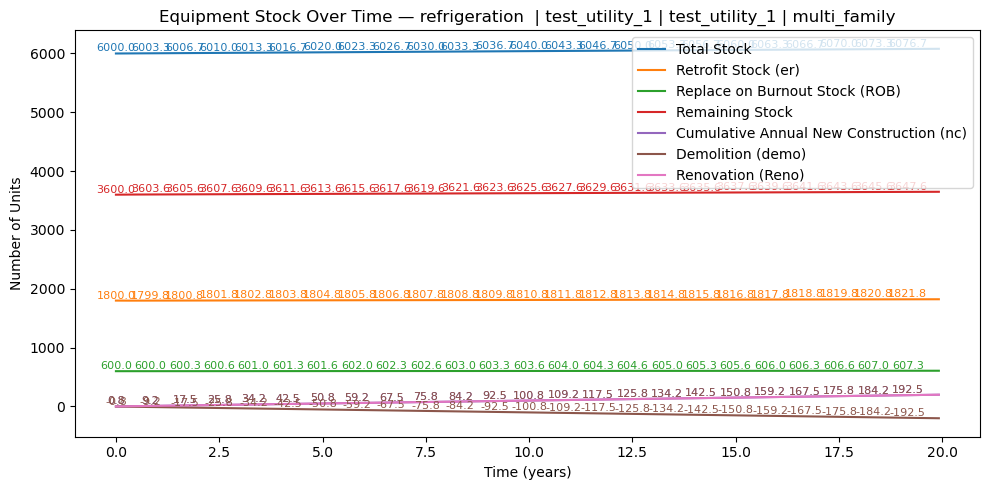

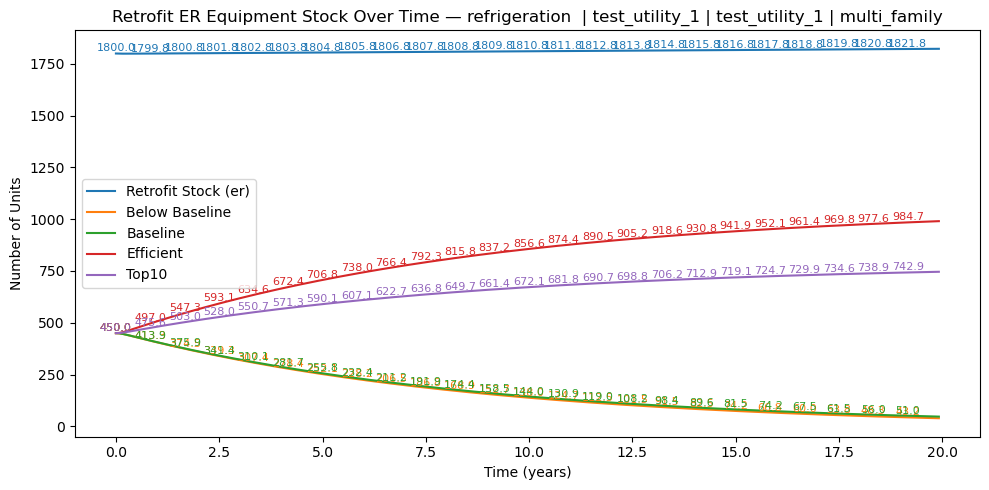

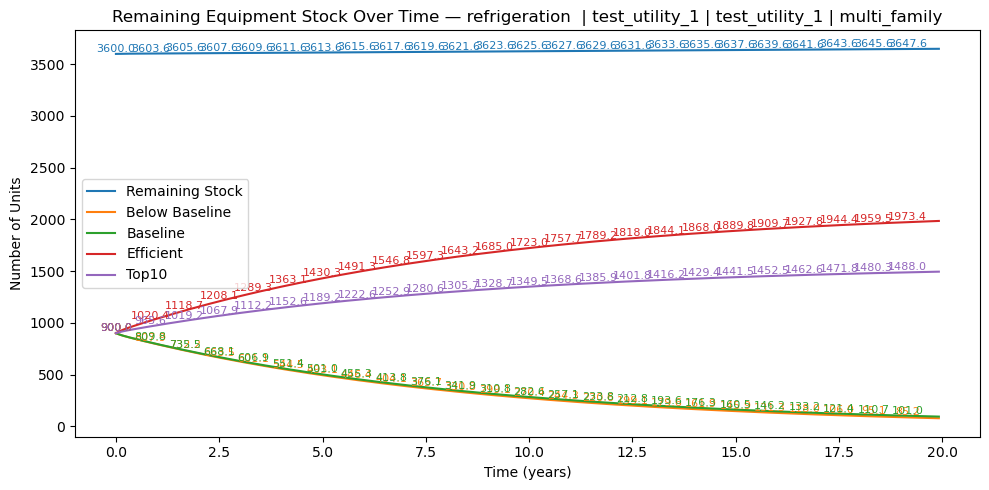

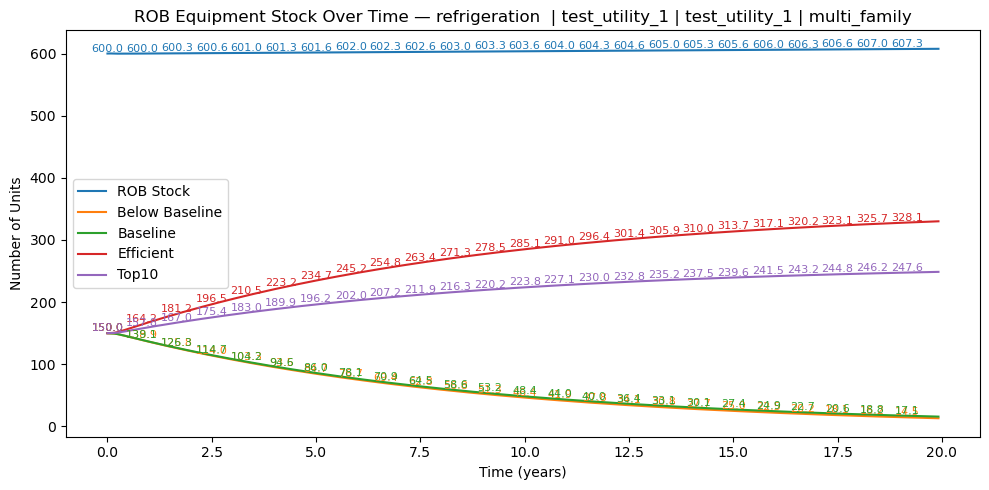

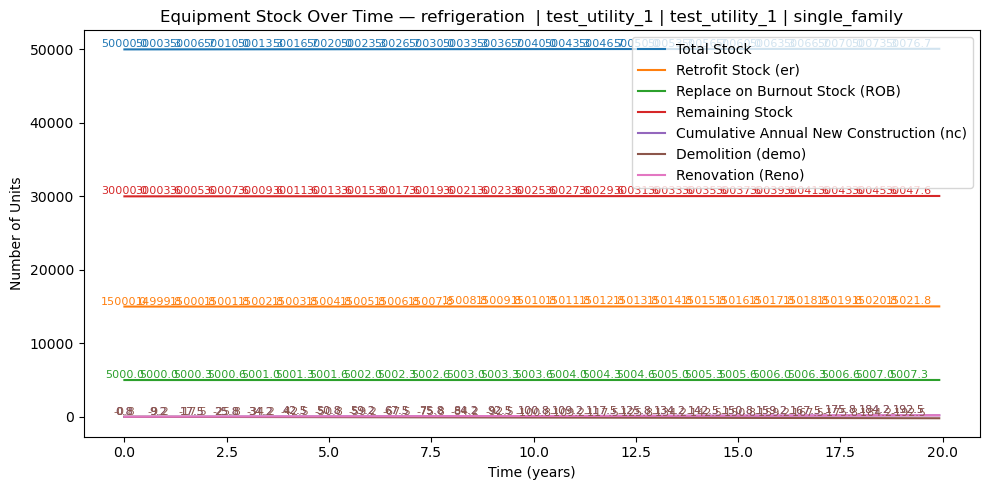

...

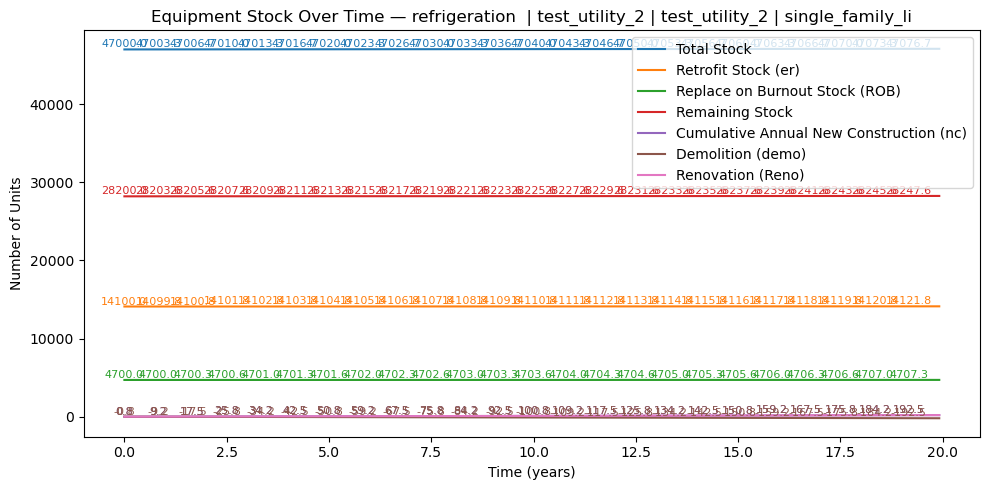

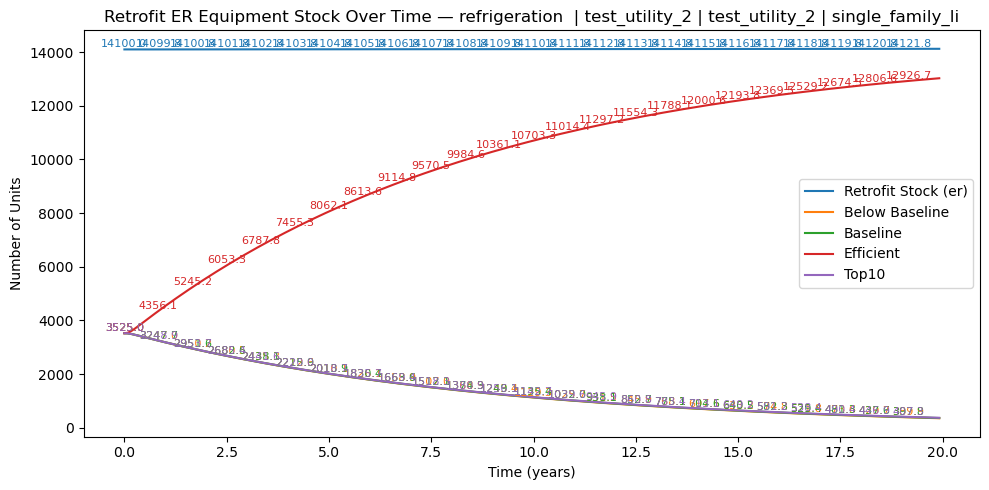

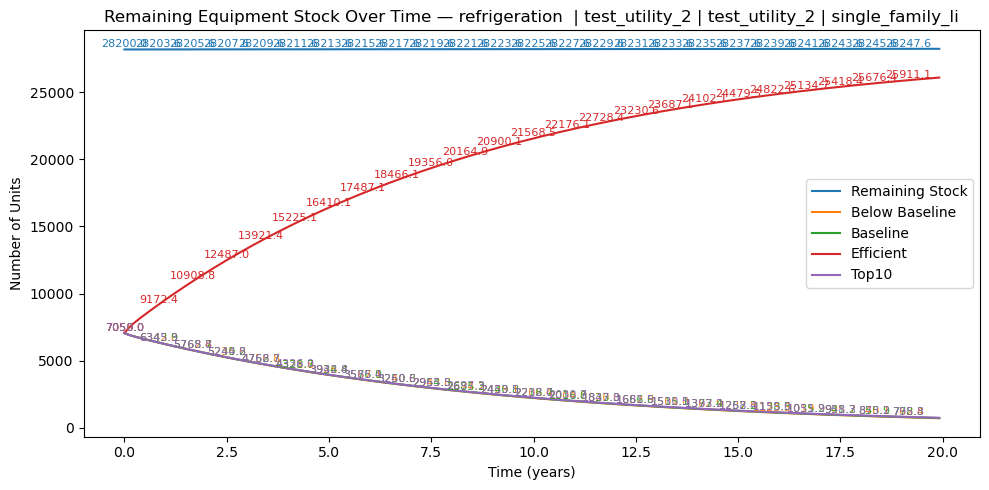

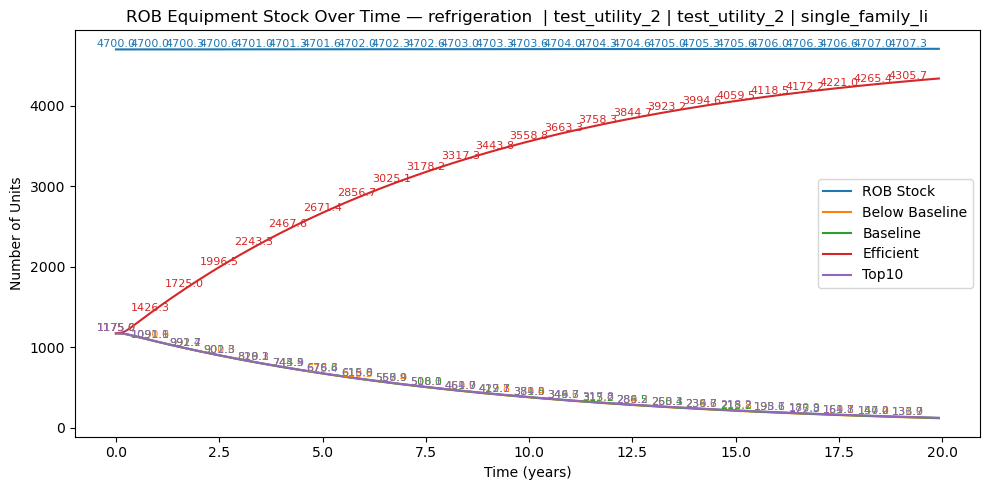

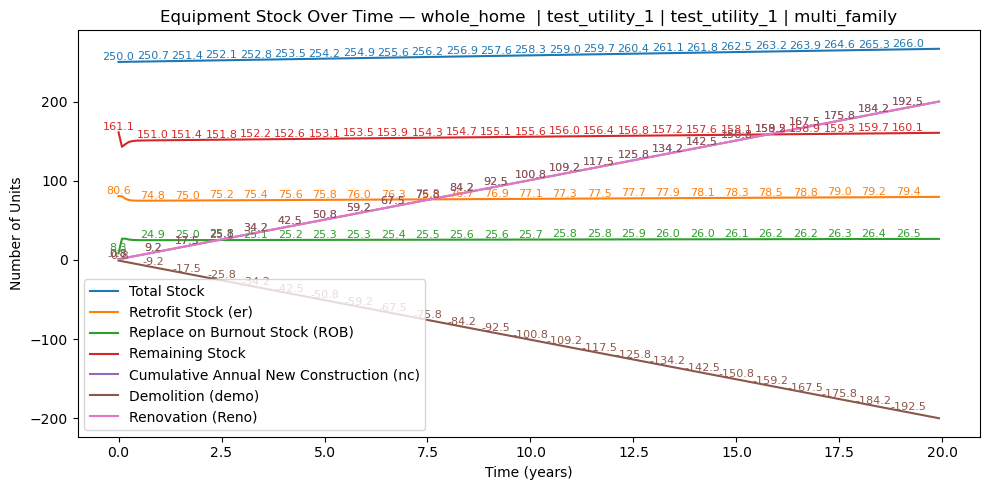

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

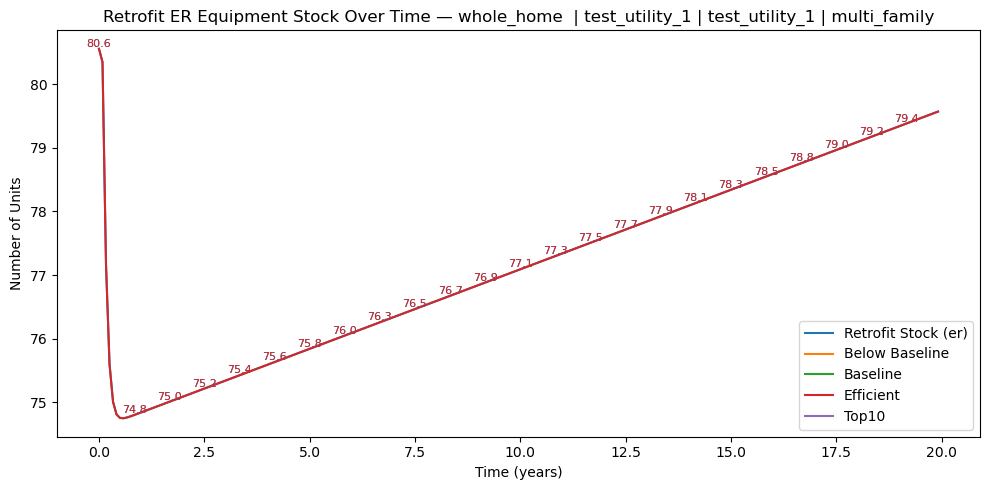

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

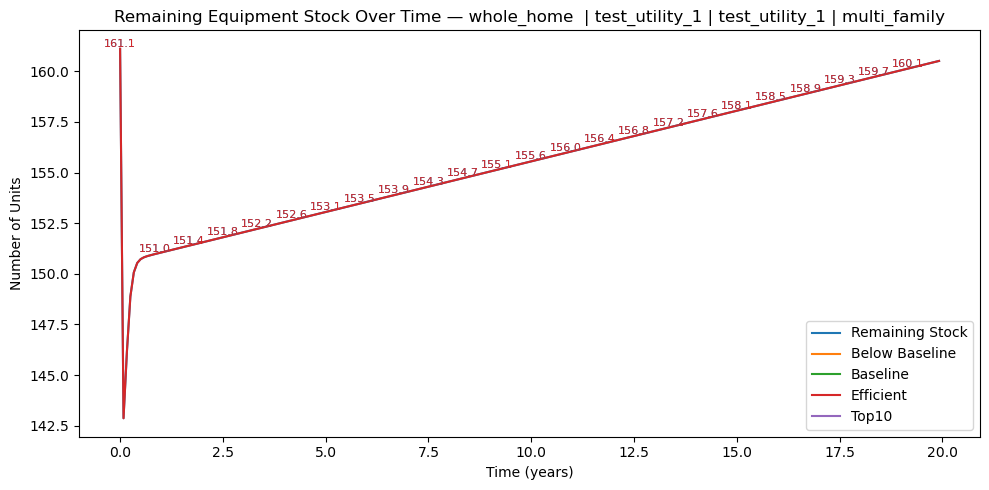

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

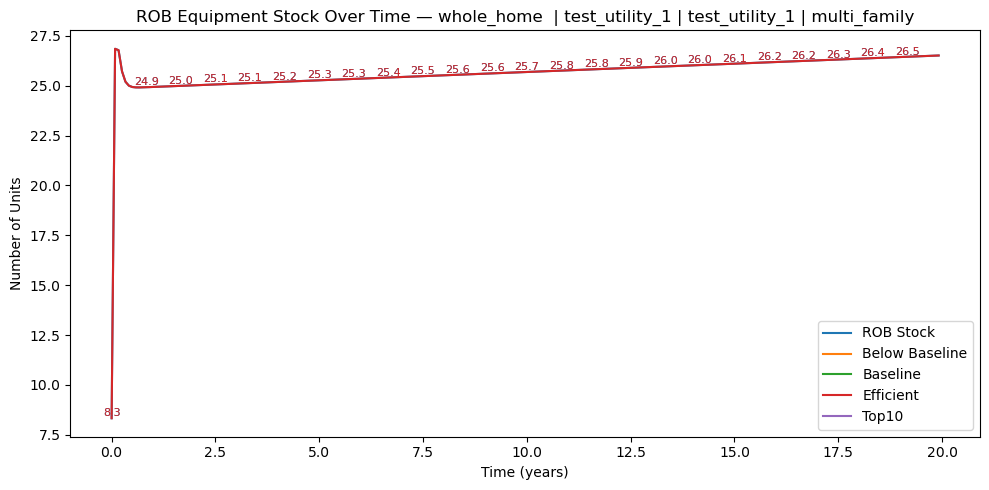

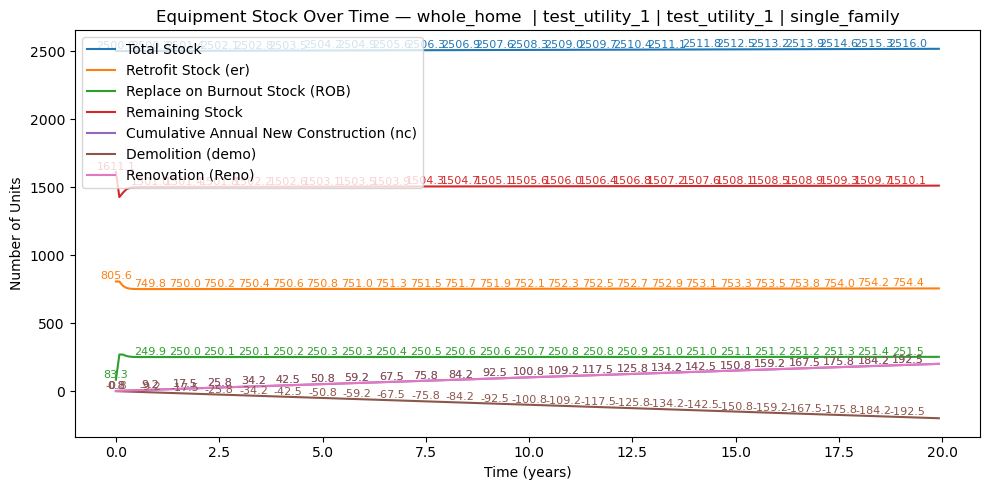

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

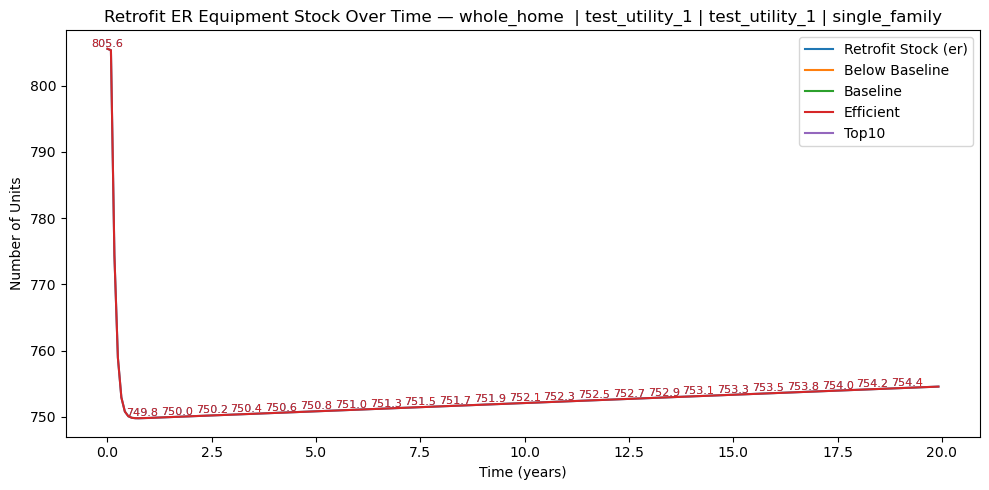

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

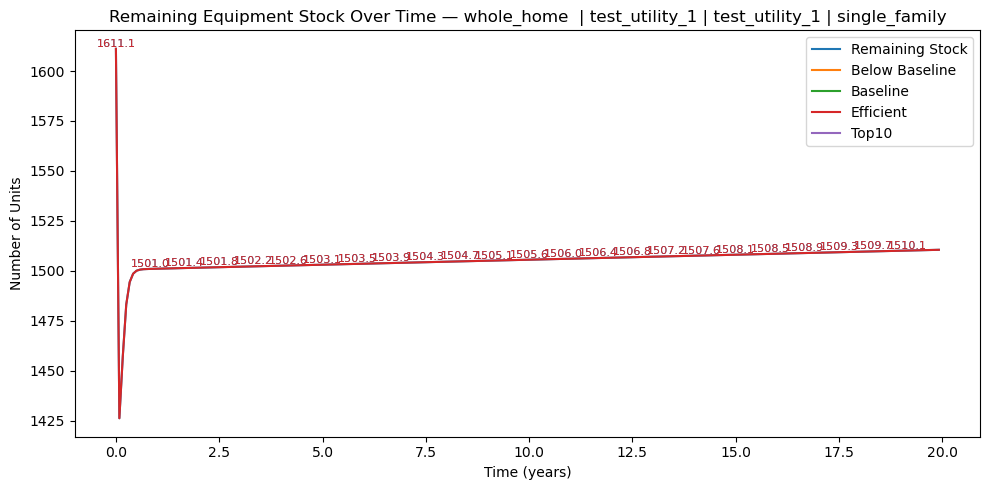

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

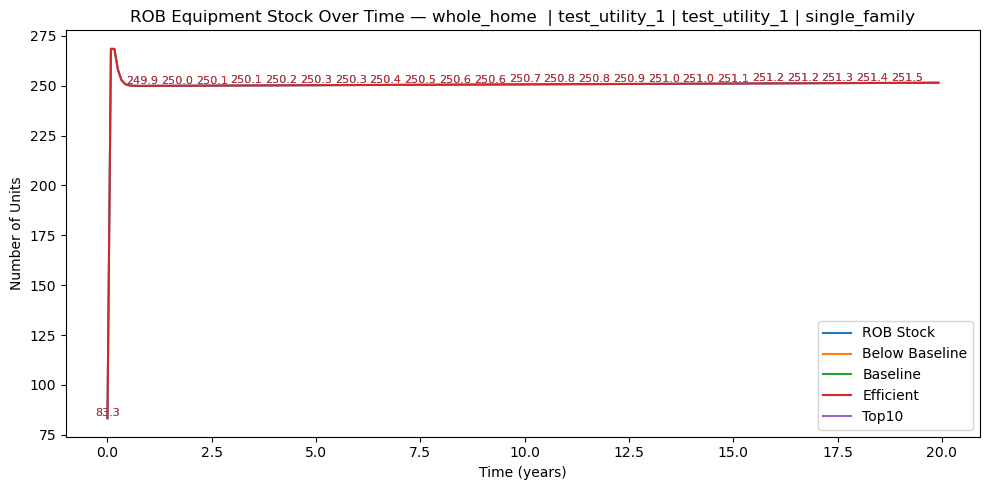

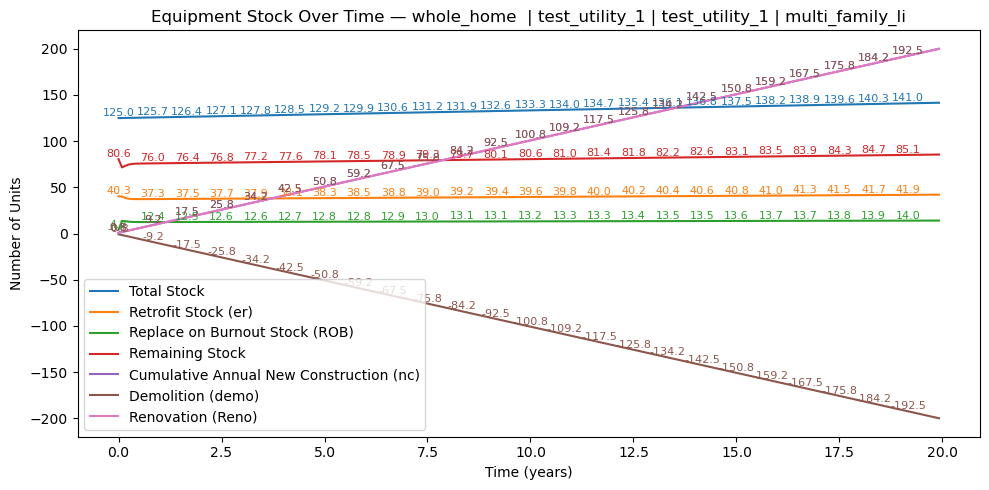

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

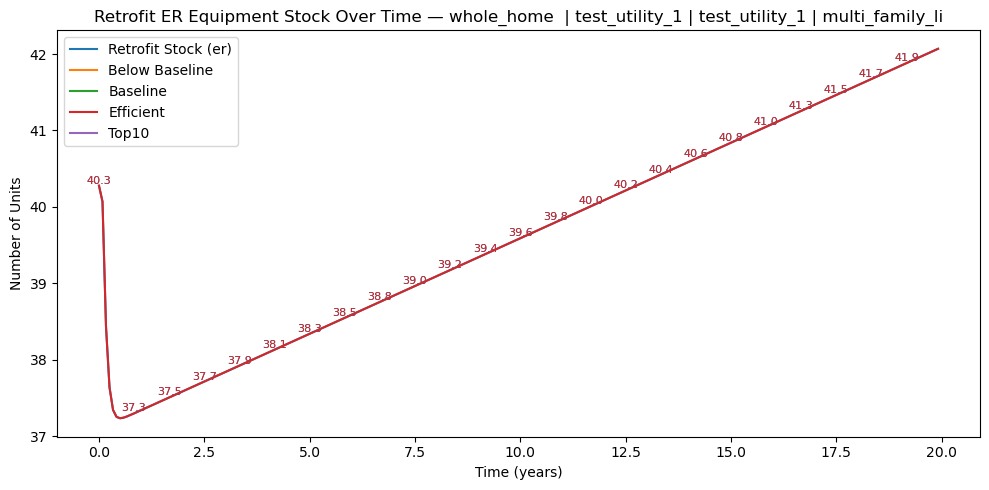

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

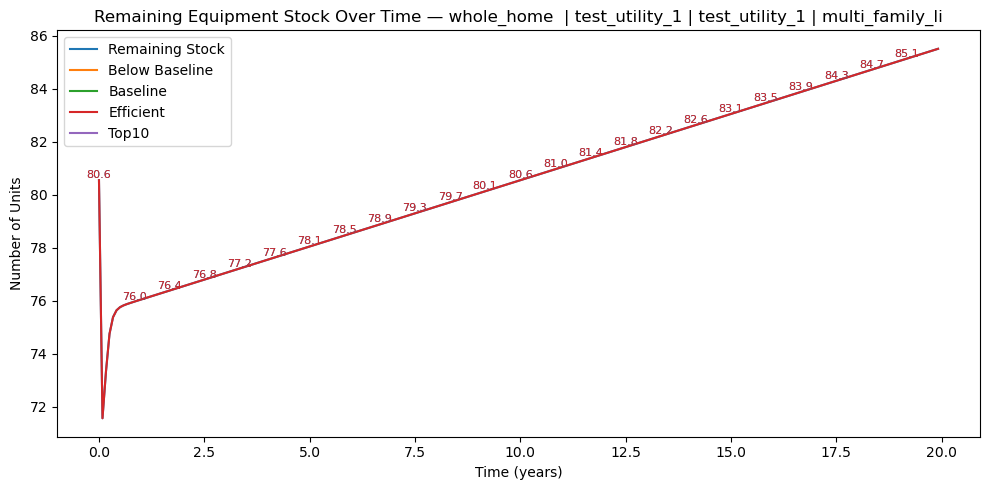

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

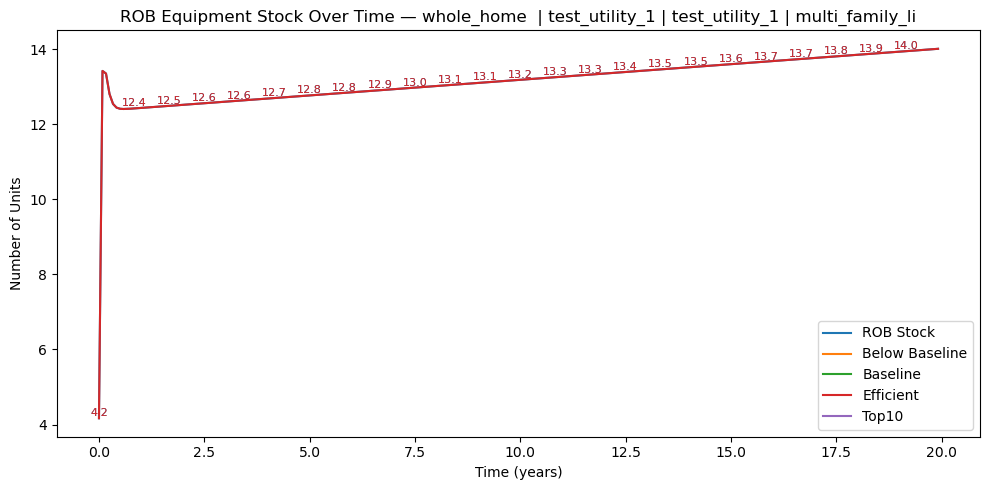

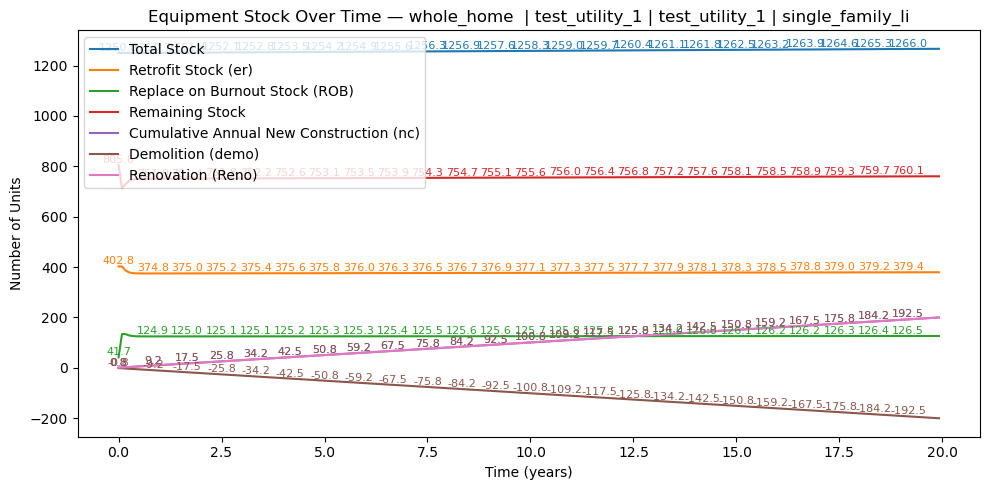

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

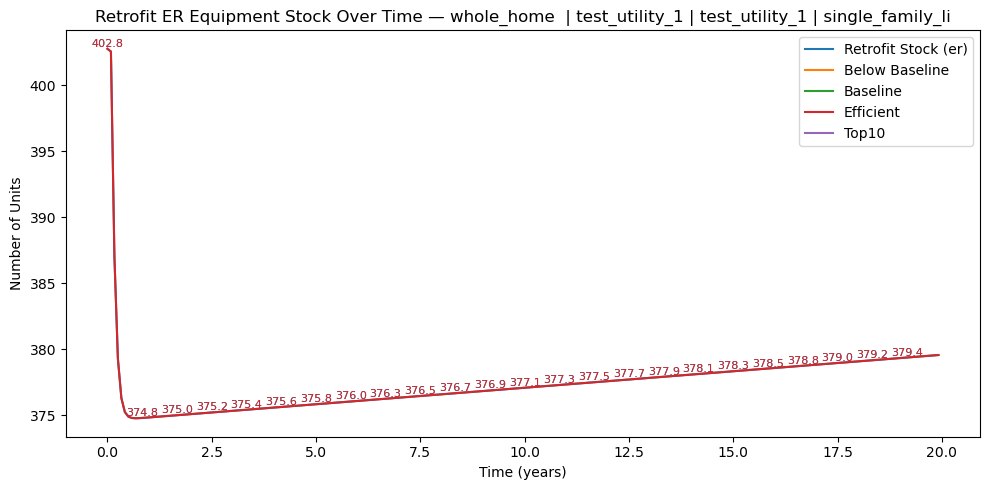

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

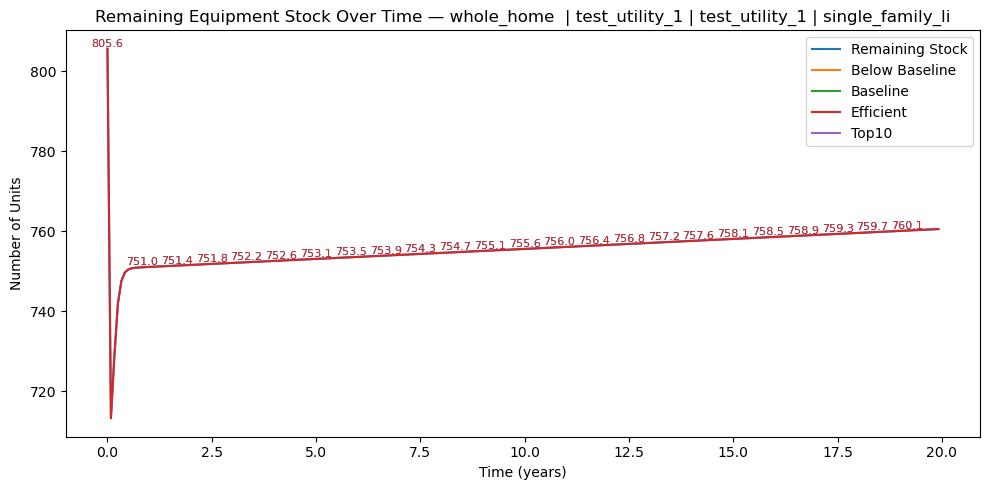

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

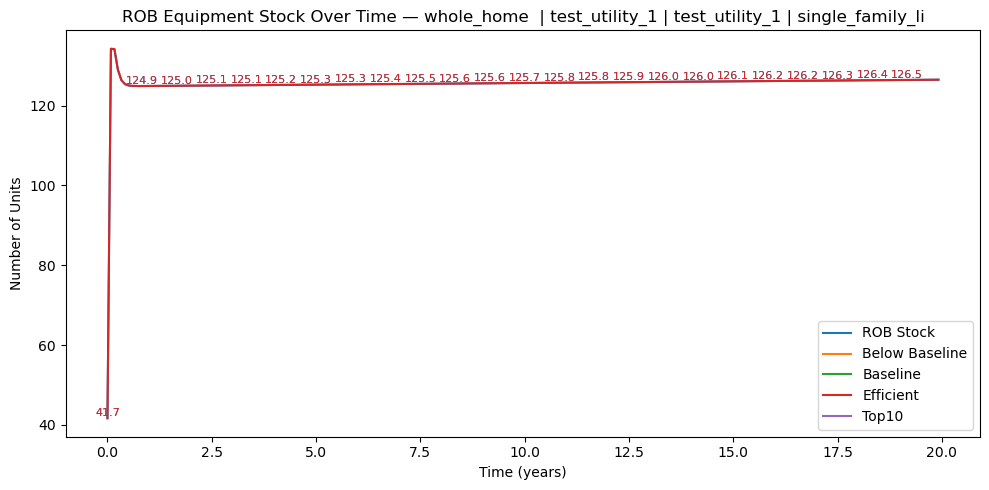

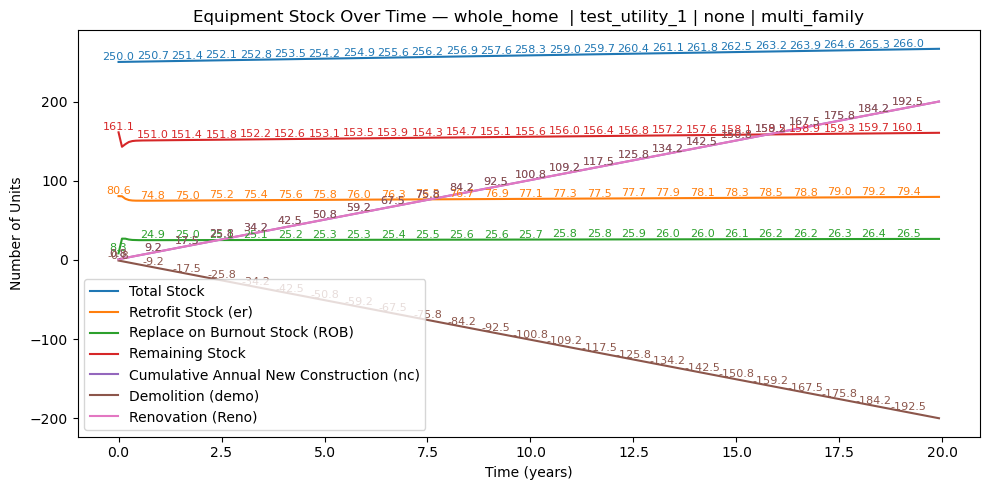

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

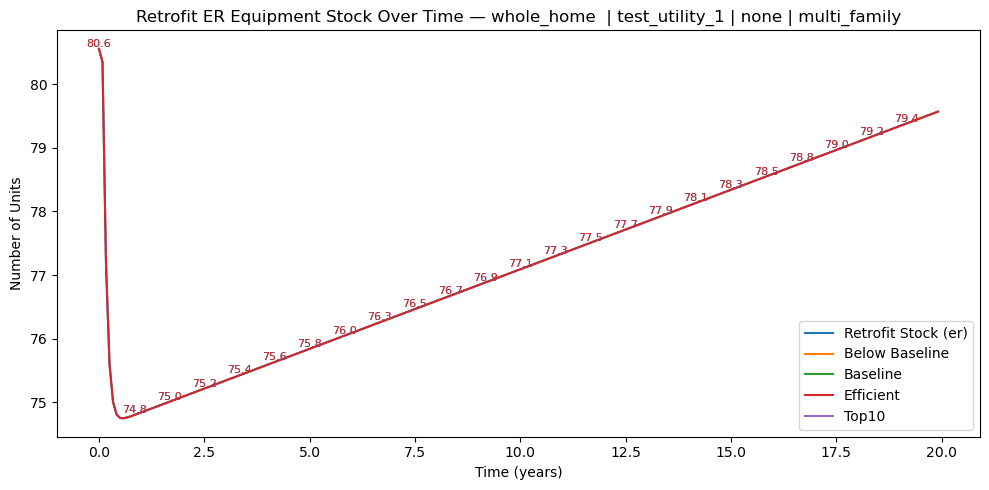

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

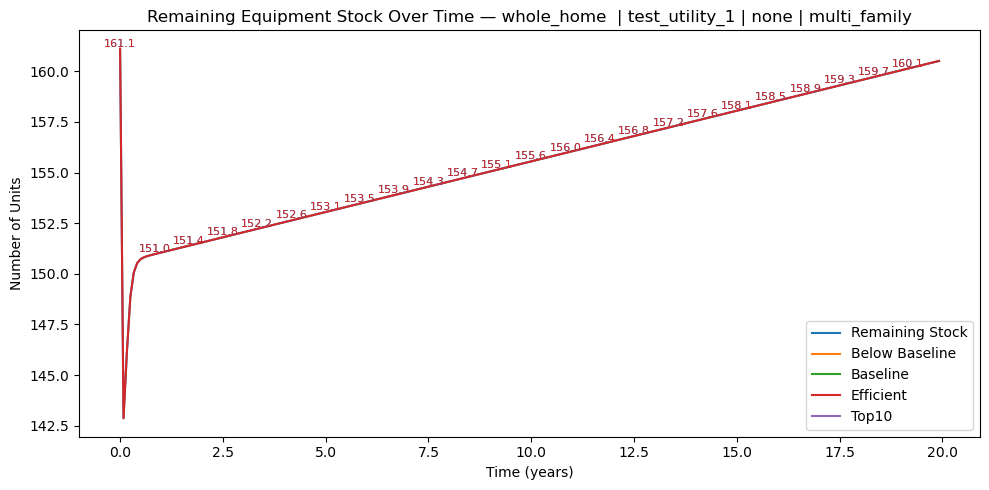

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

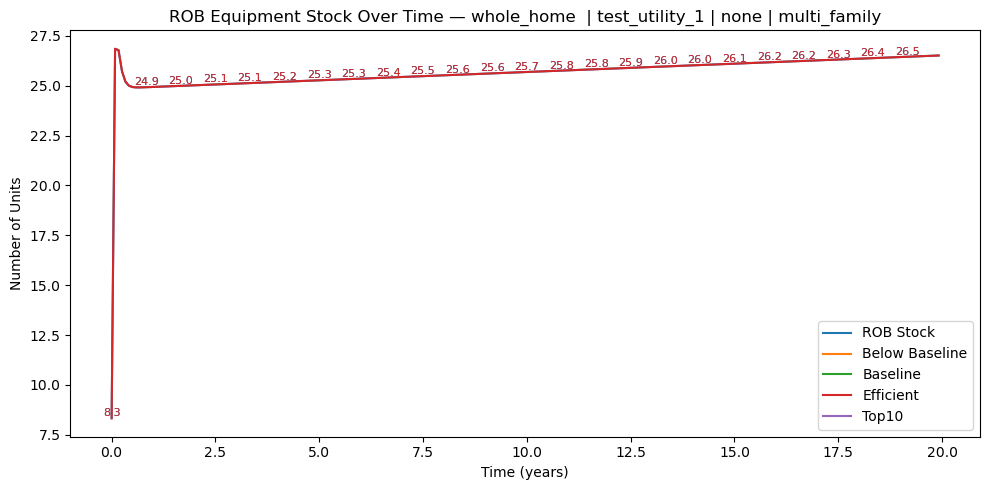

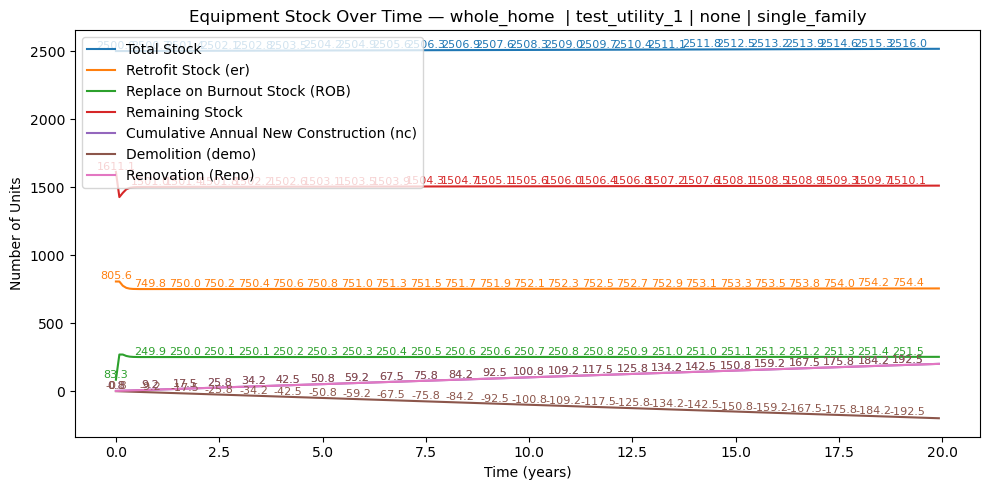

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

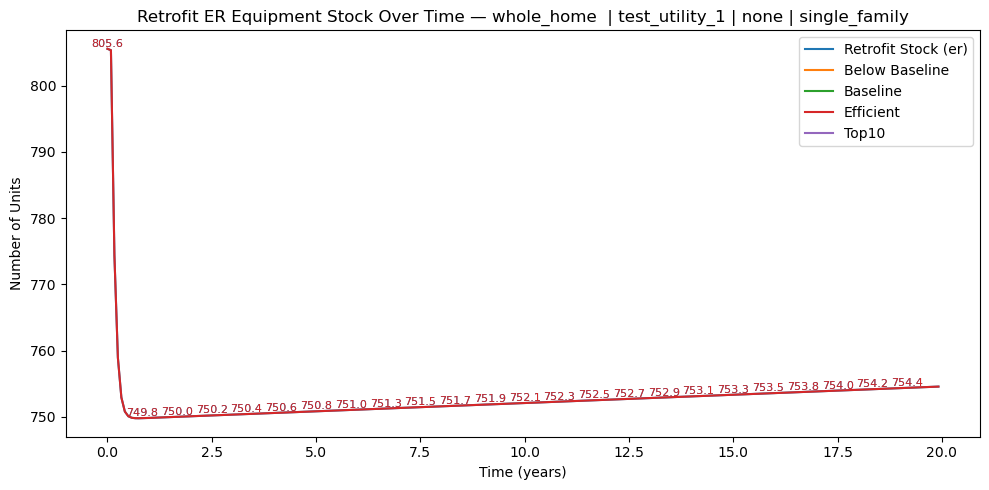

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

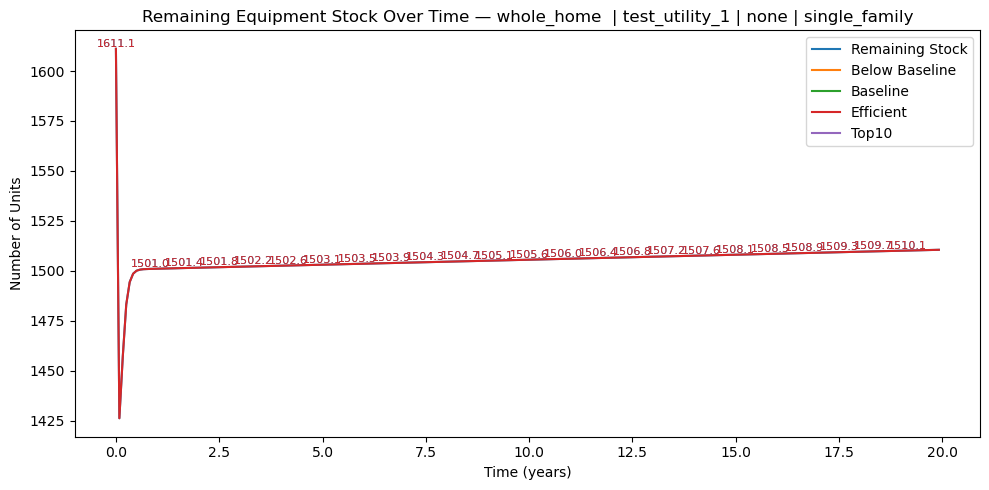

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

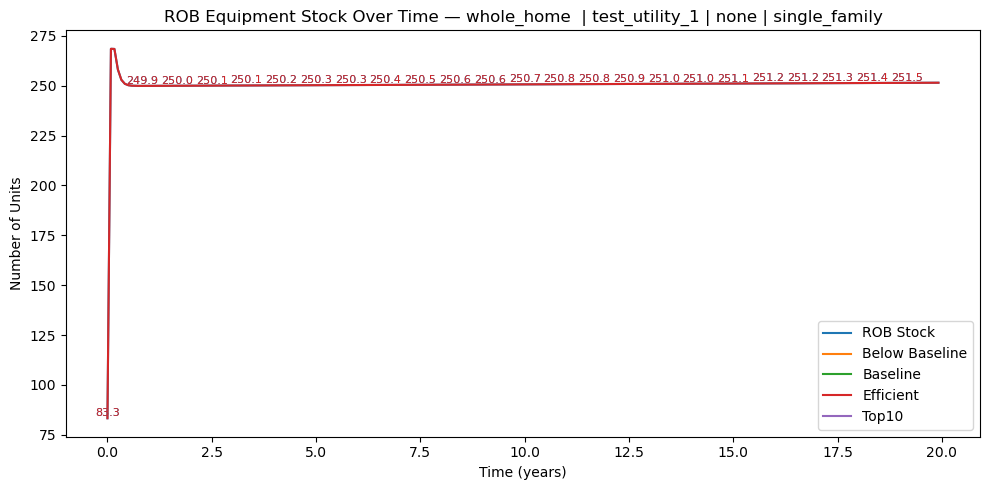

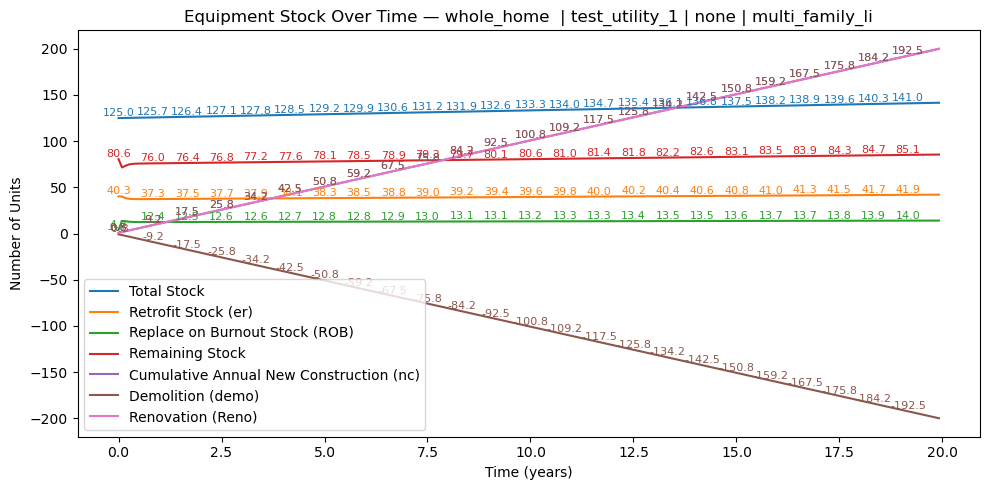

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

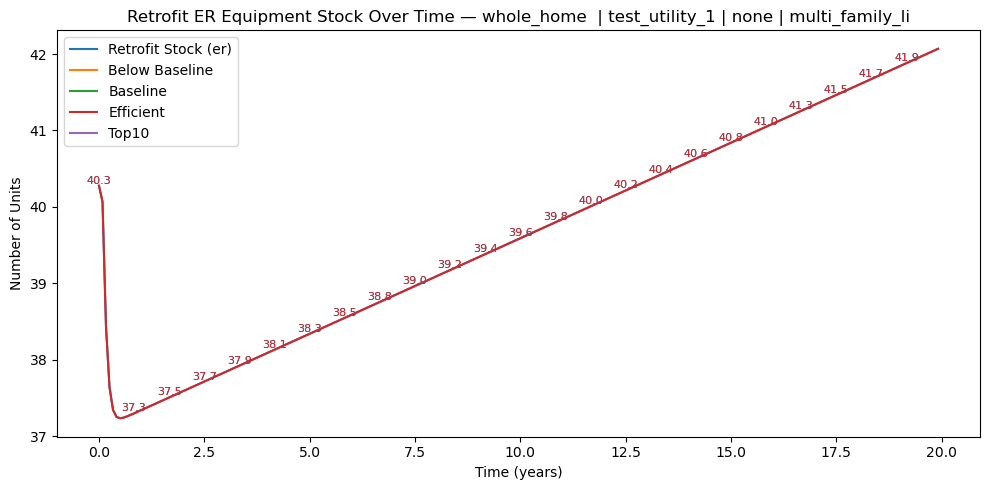

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

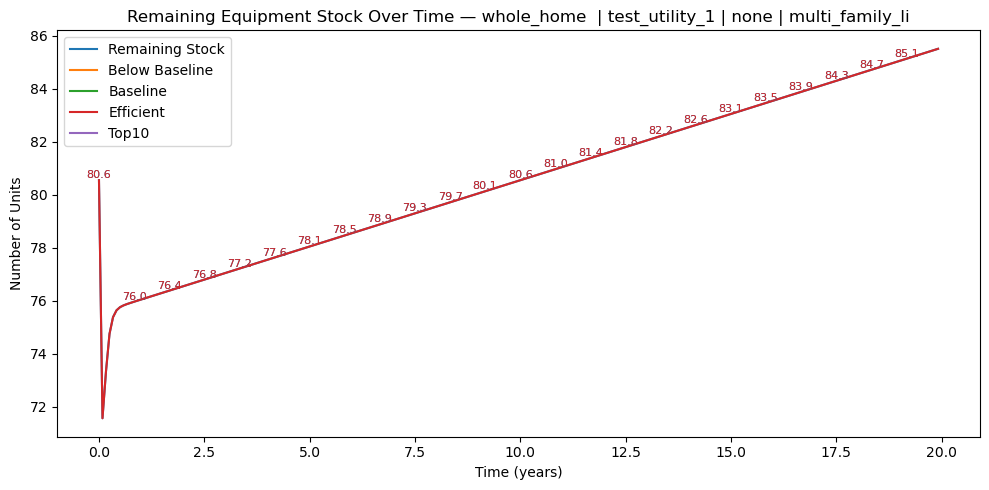

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

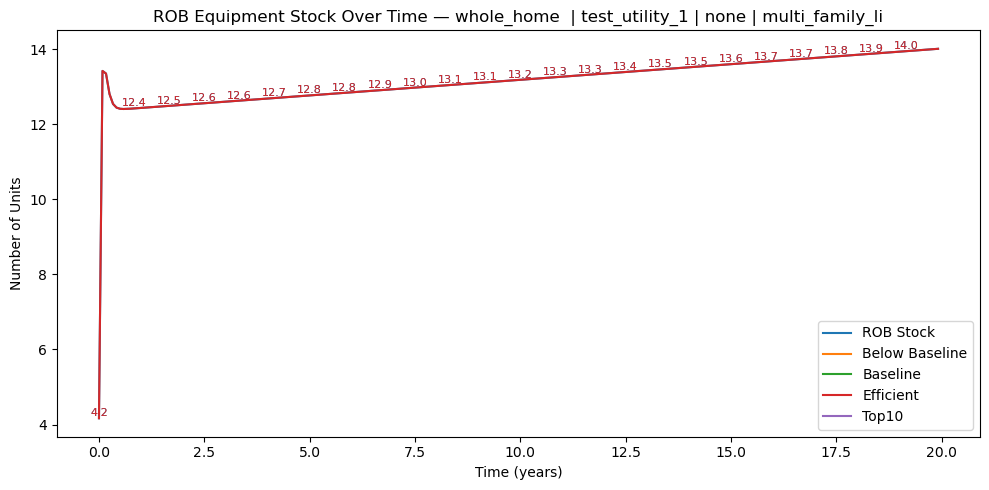

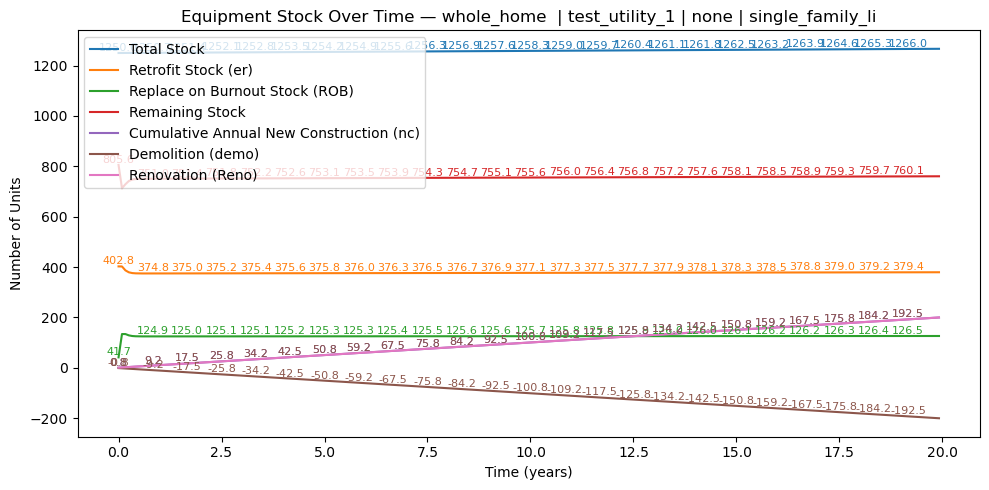

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

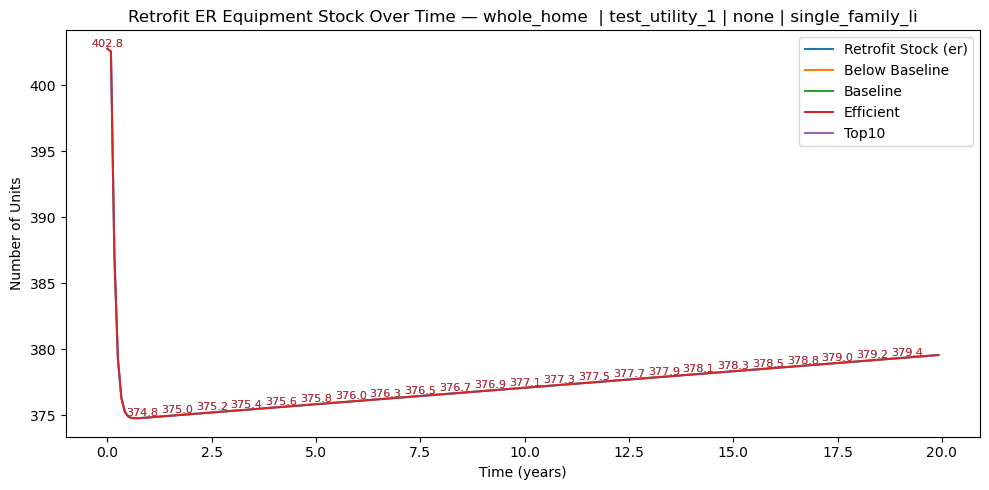

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

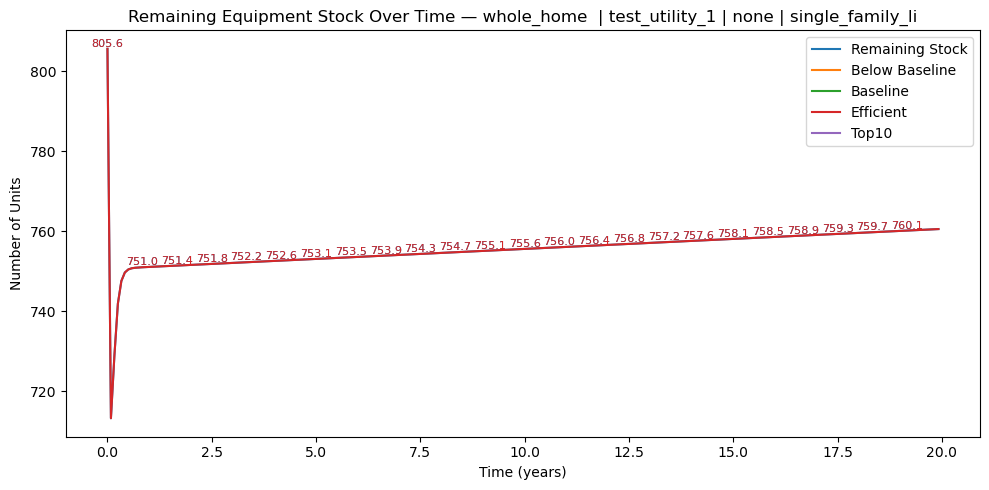

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

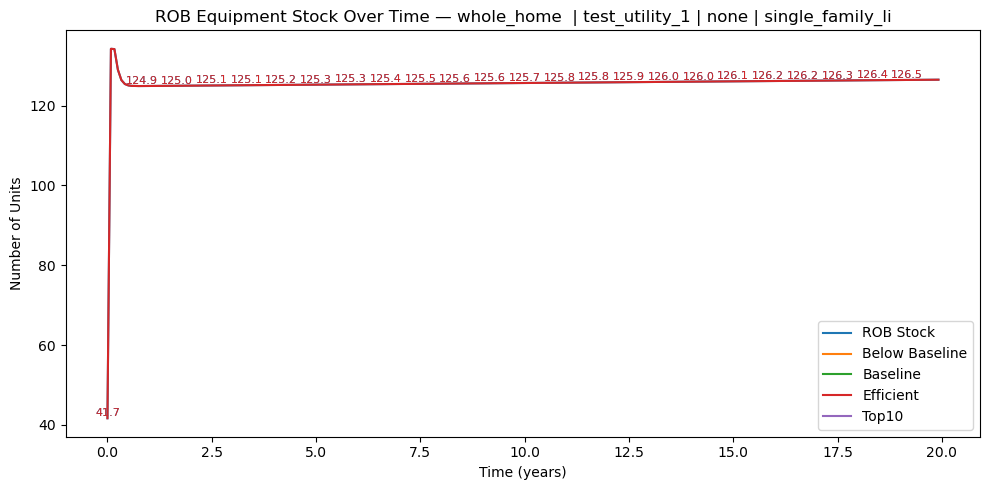

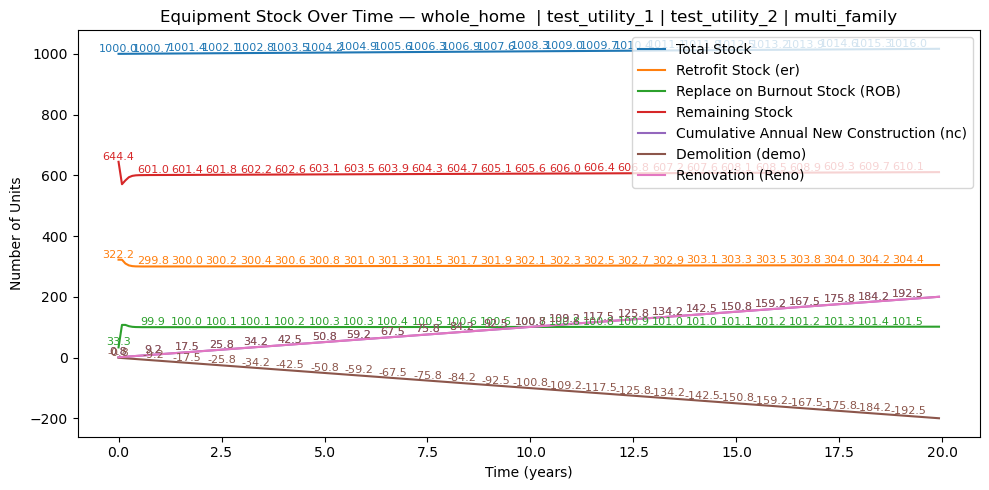

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

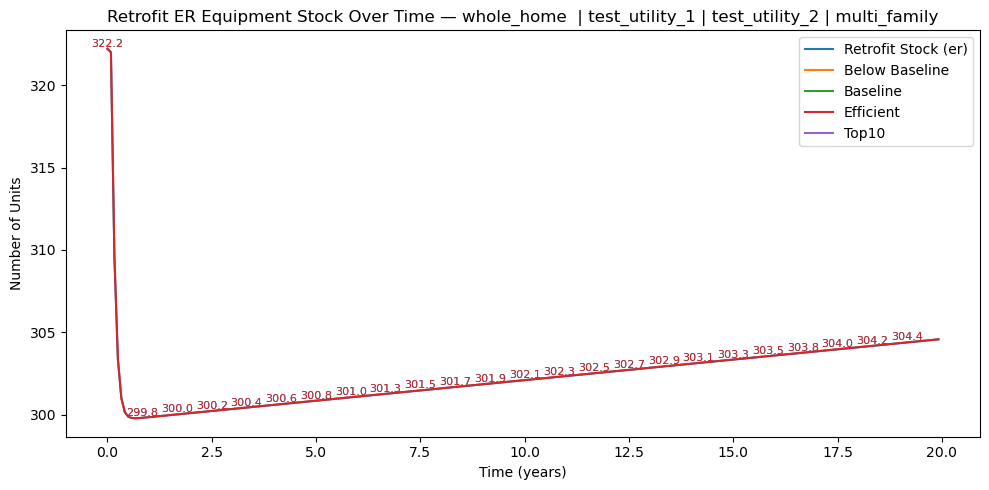

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

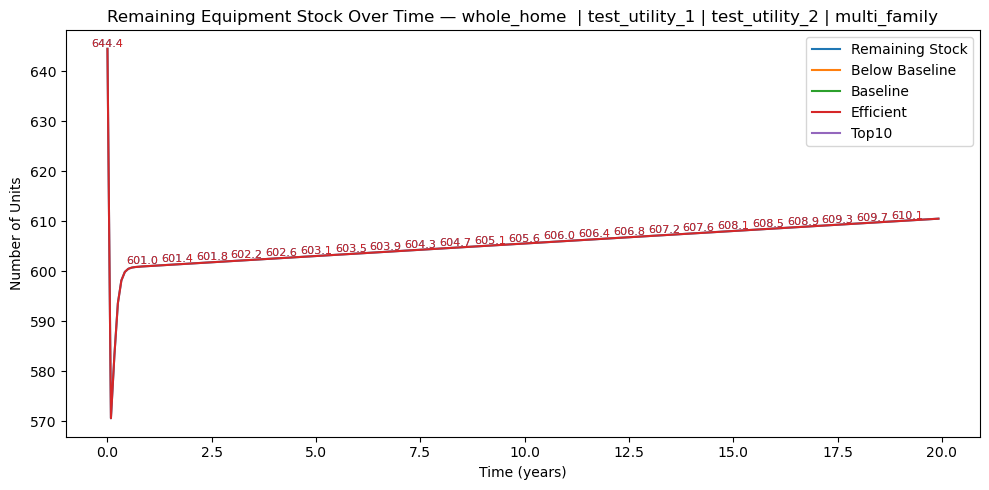

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

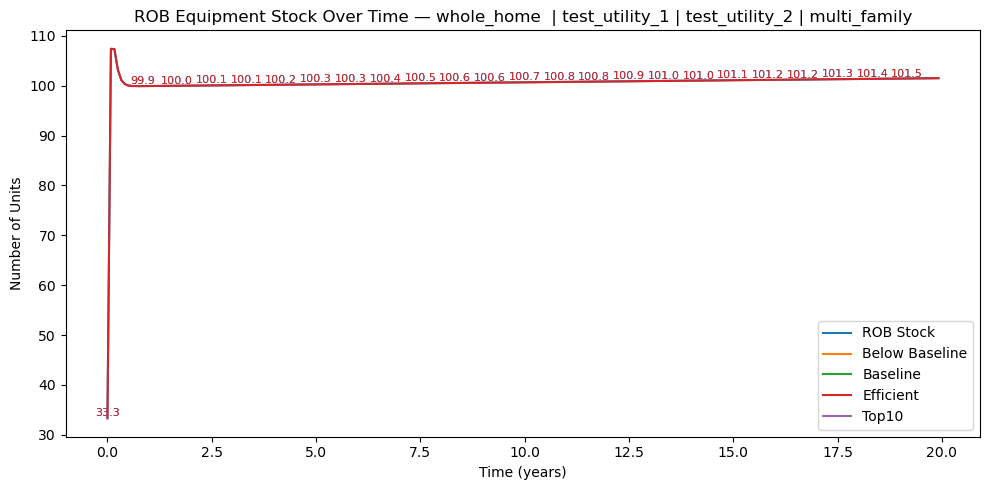

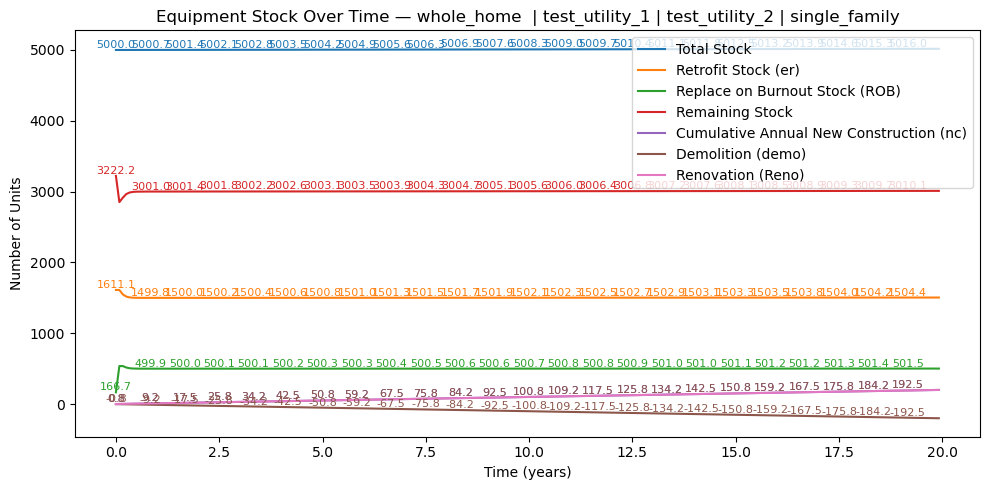

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

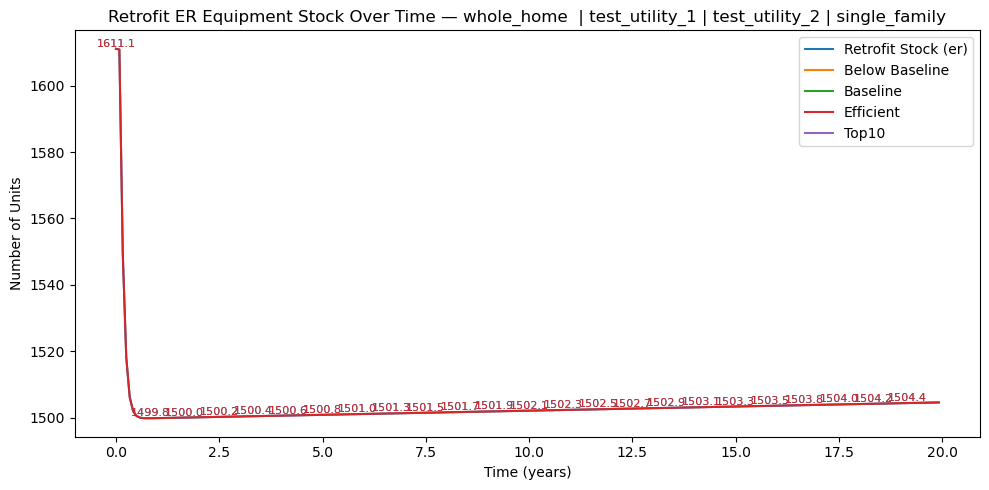

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

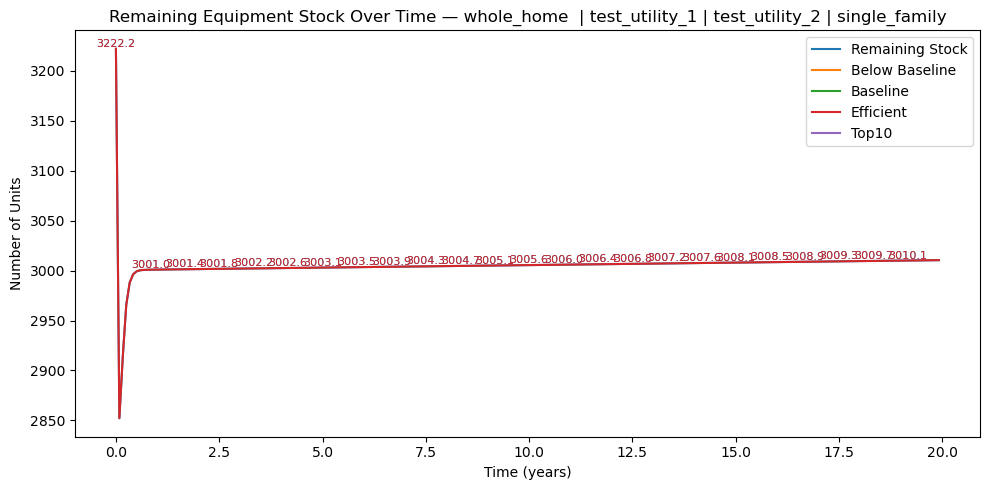

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

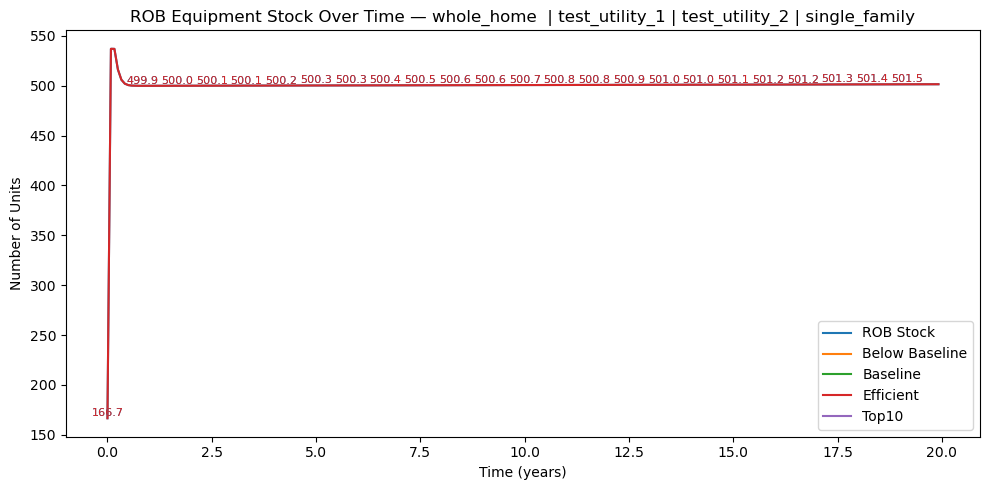

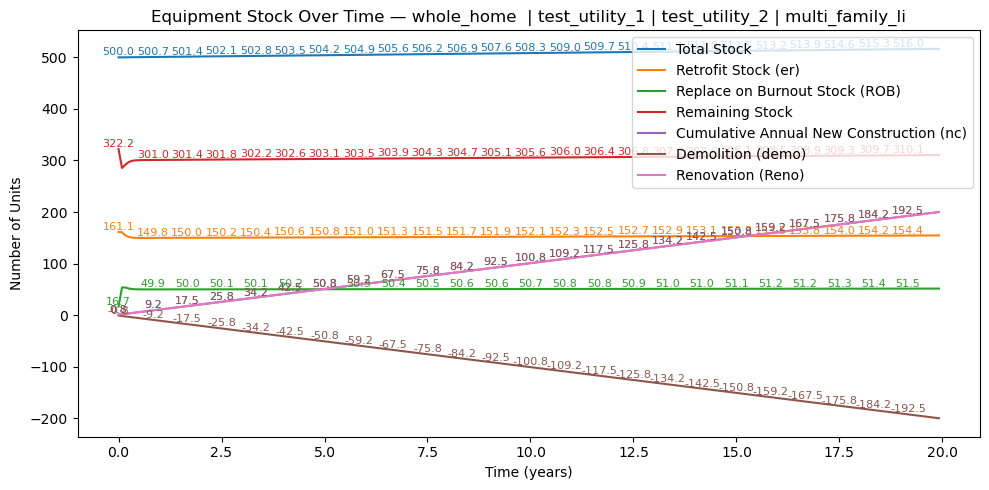

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

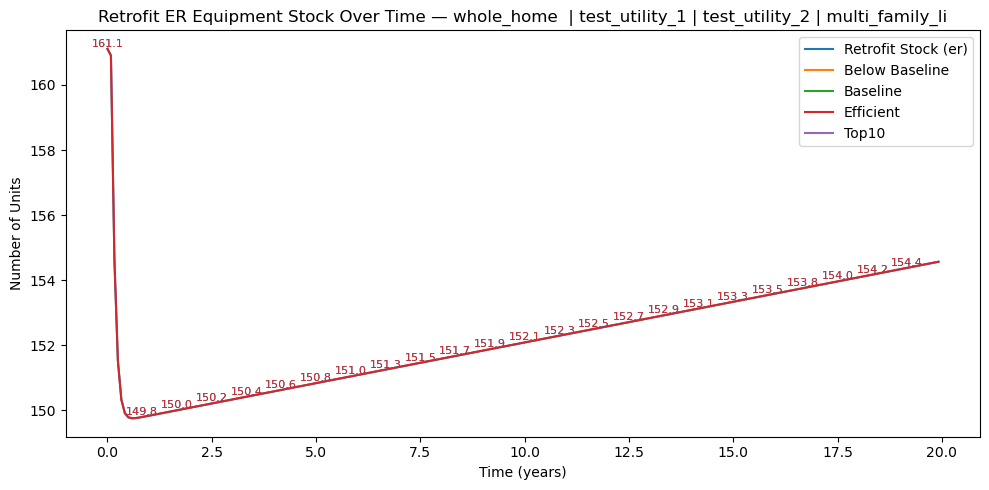

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

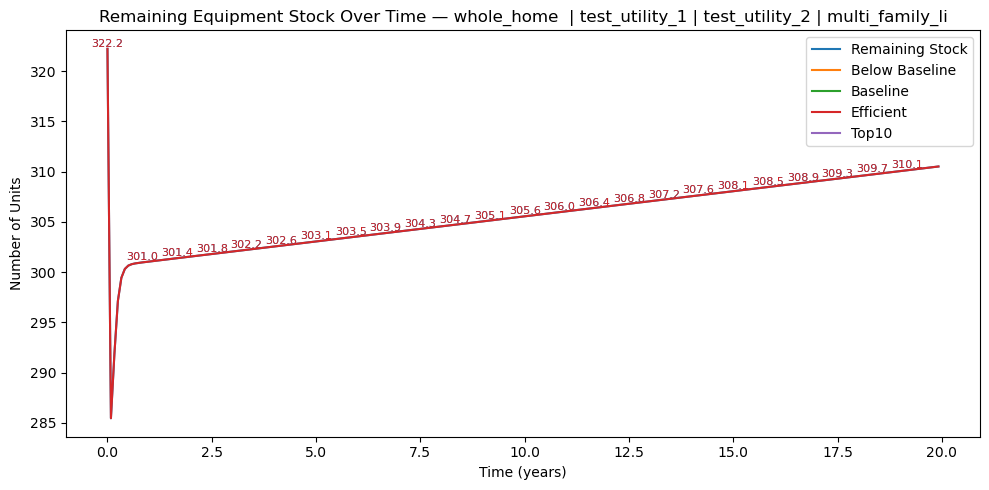

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

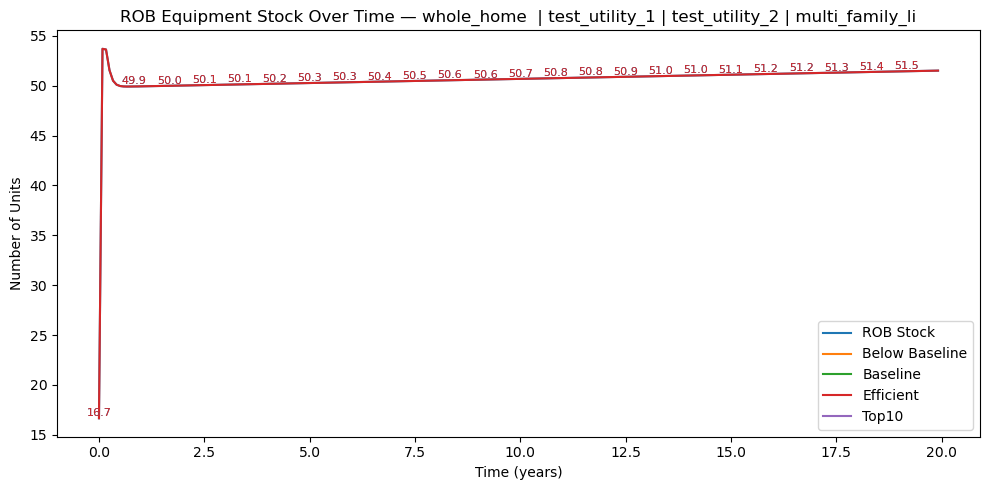

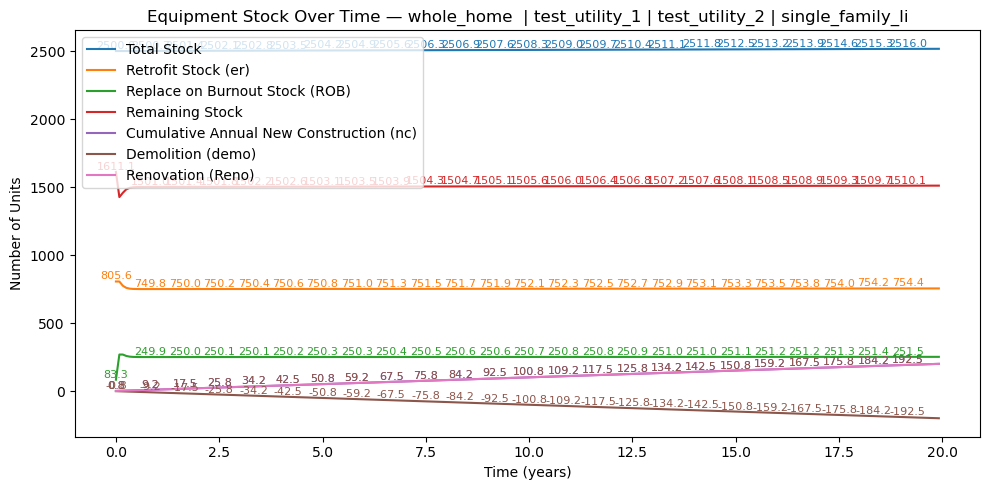

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

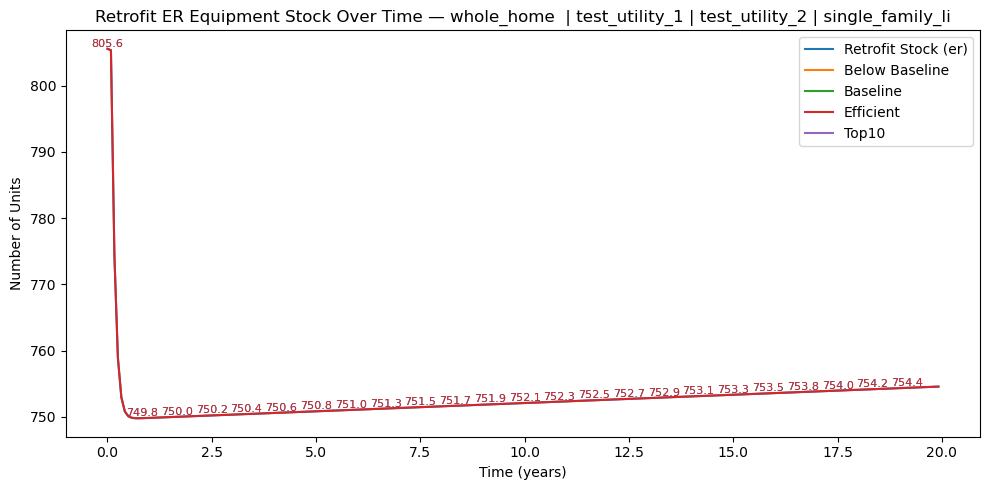

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

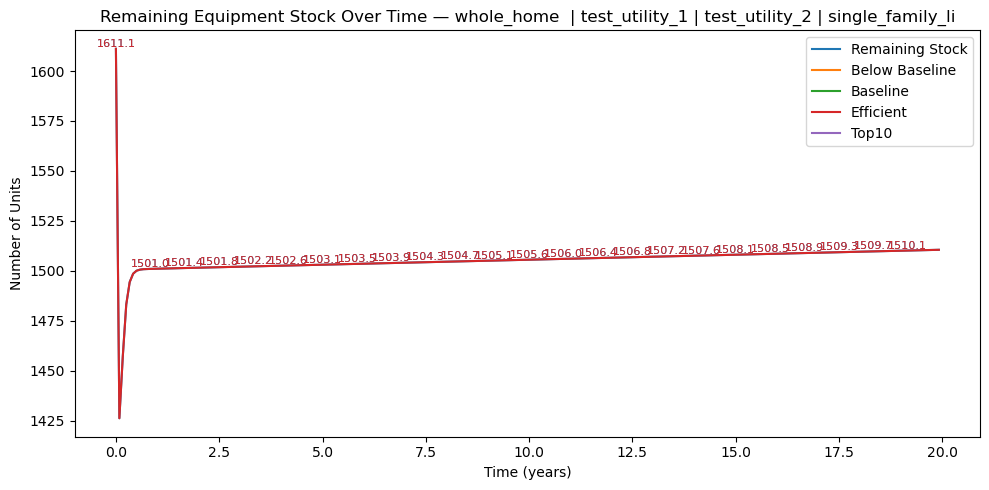

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

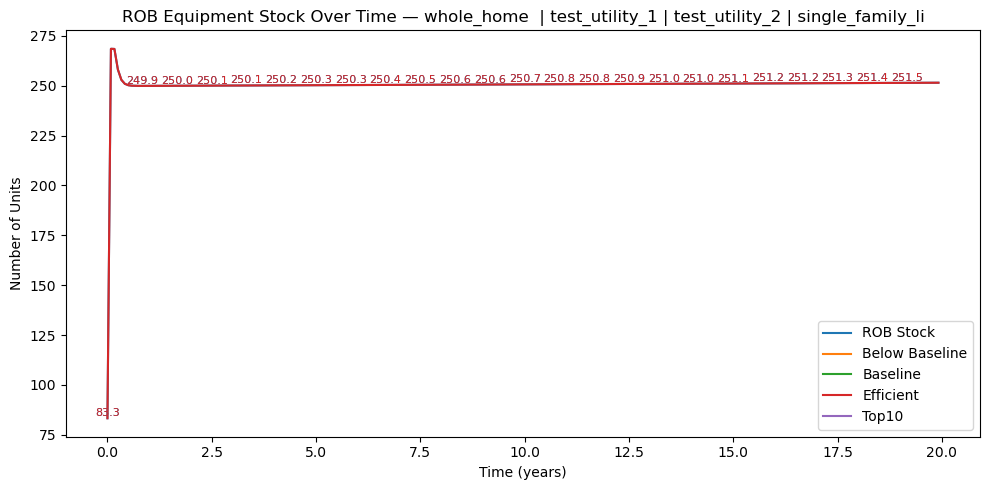

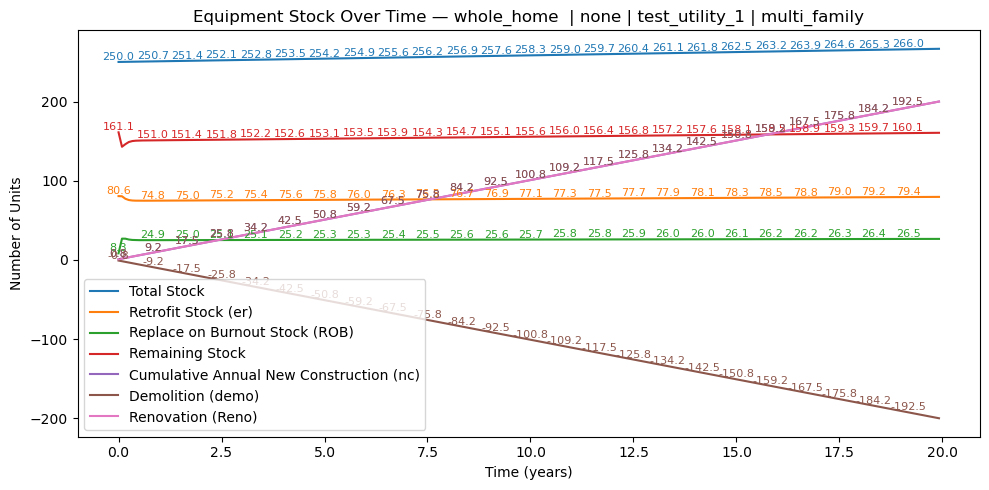

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

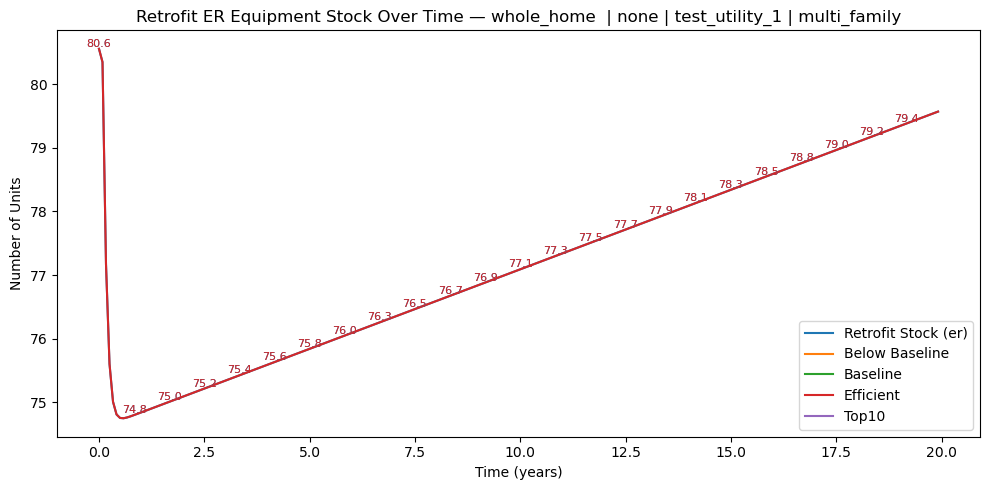

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

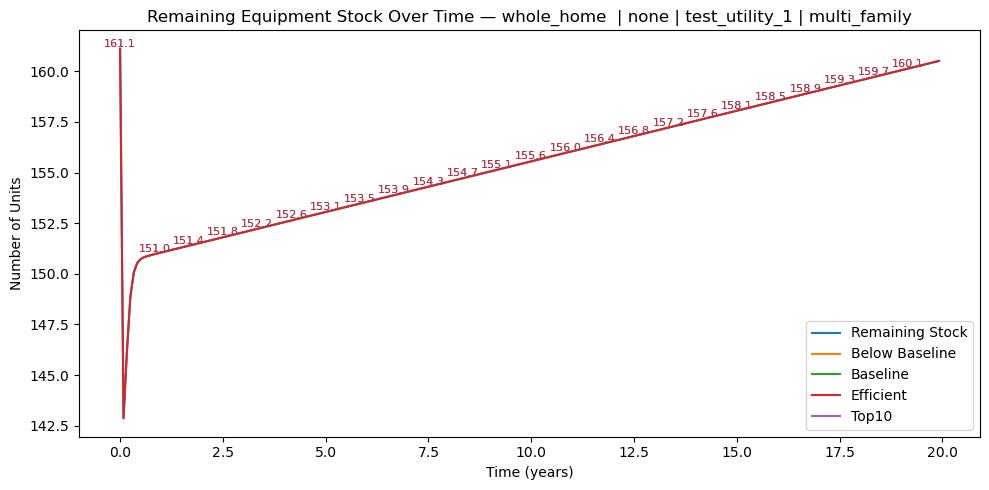

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

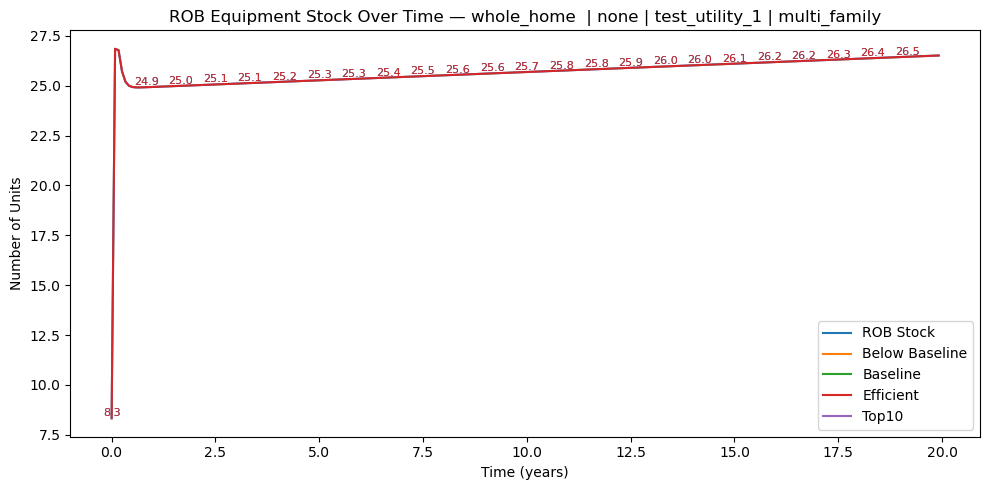

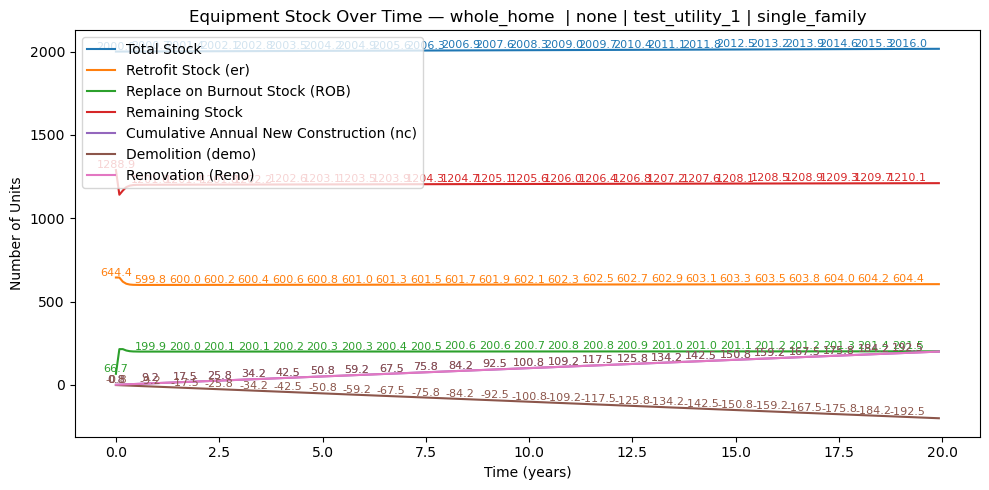

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

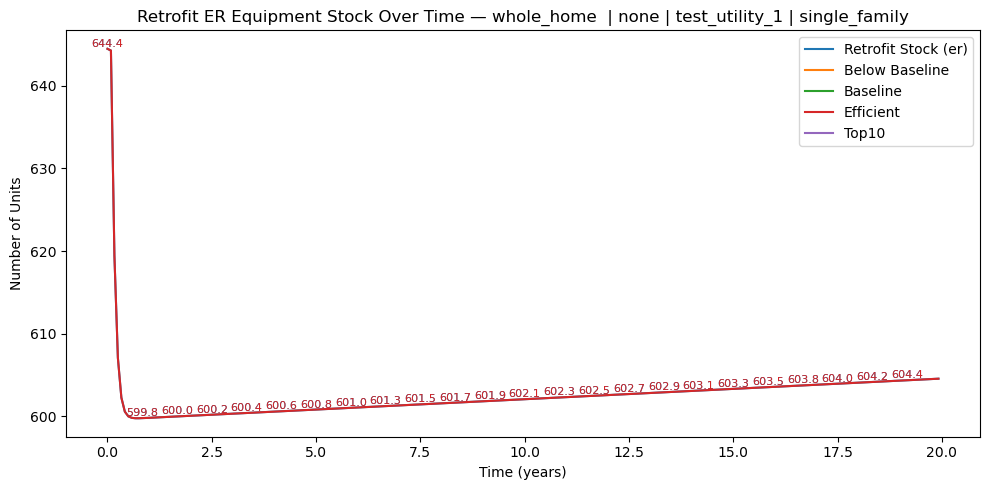

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

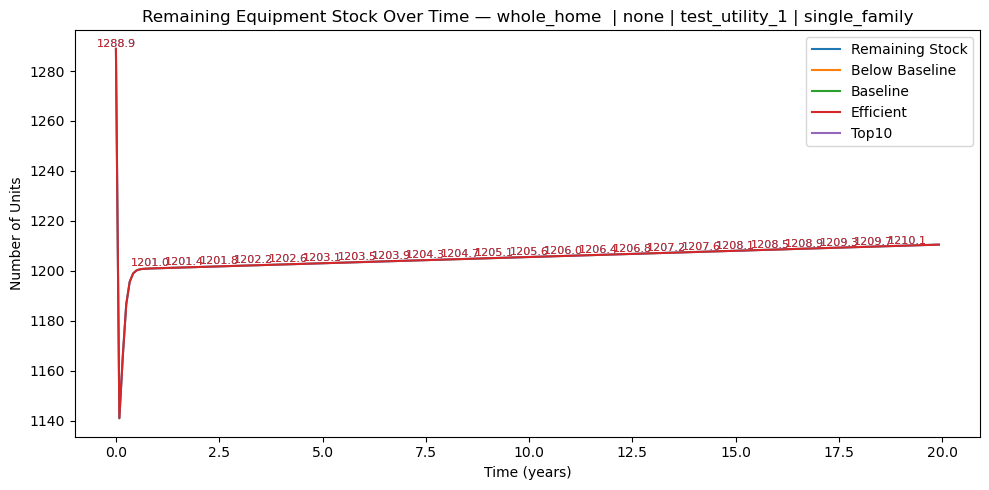

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

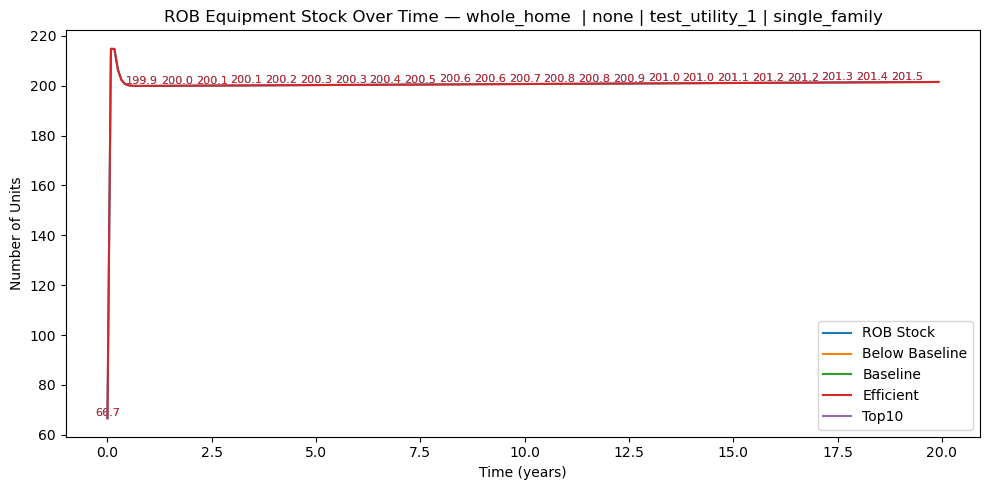

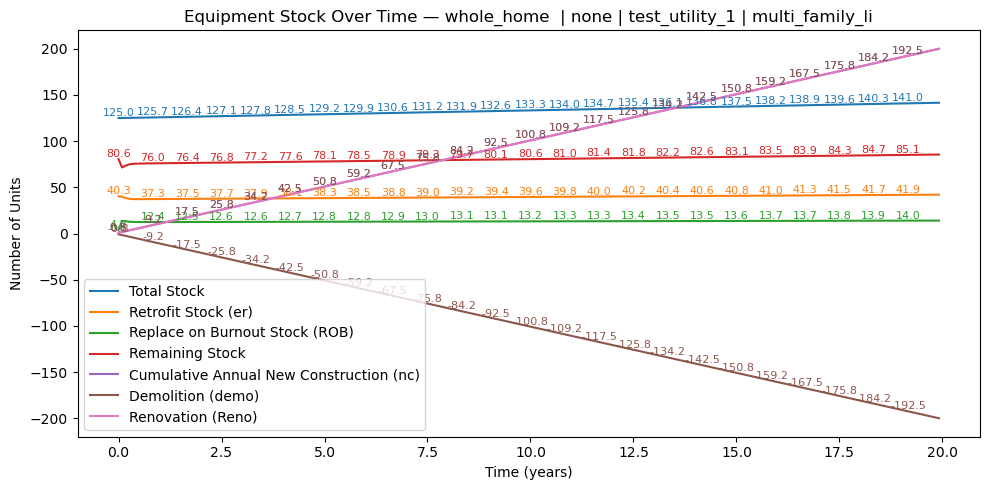

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

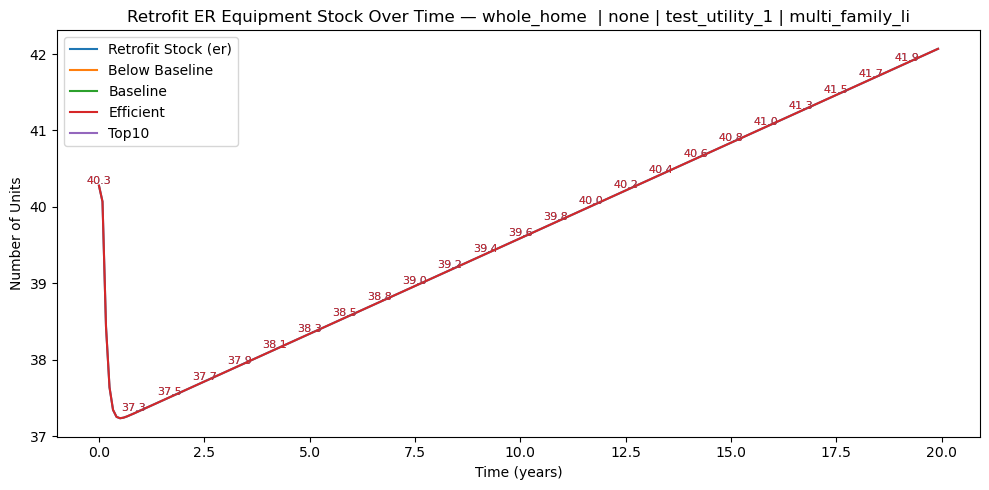

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

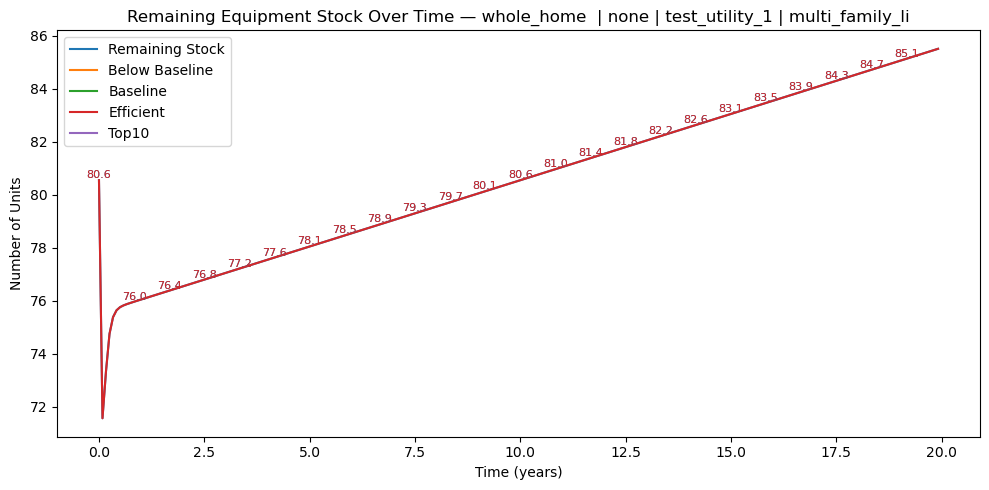

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

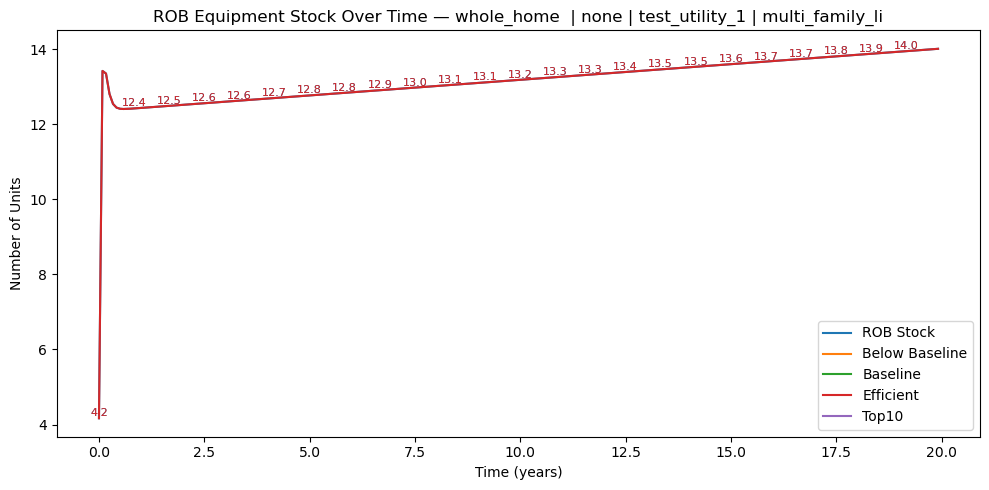

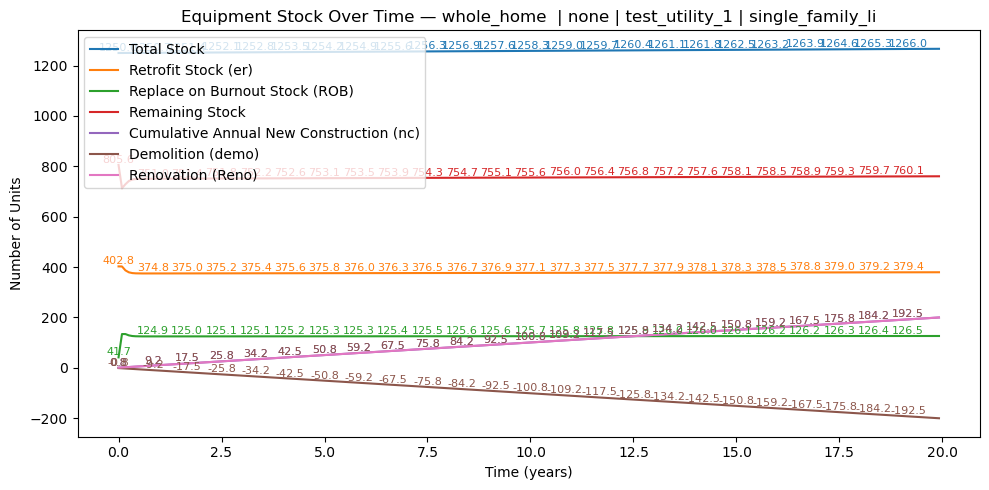

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

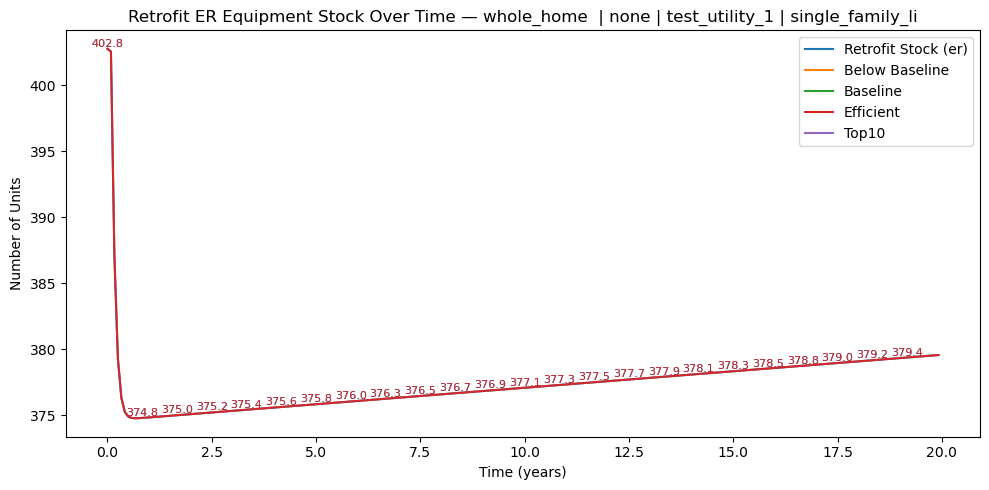

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

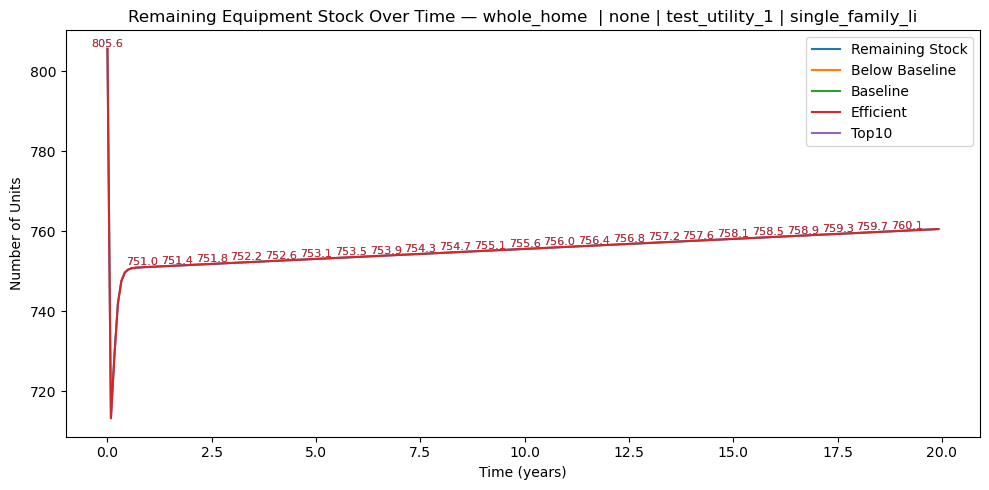

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

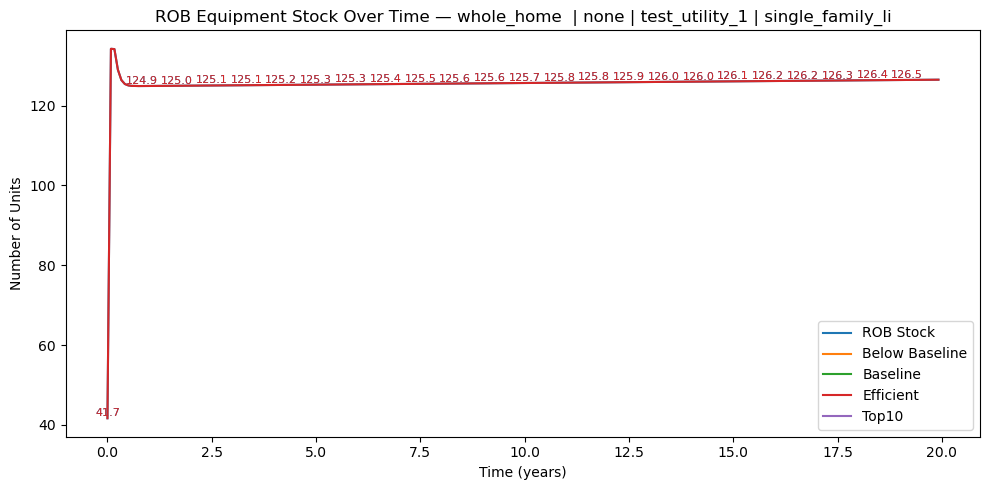

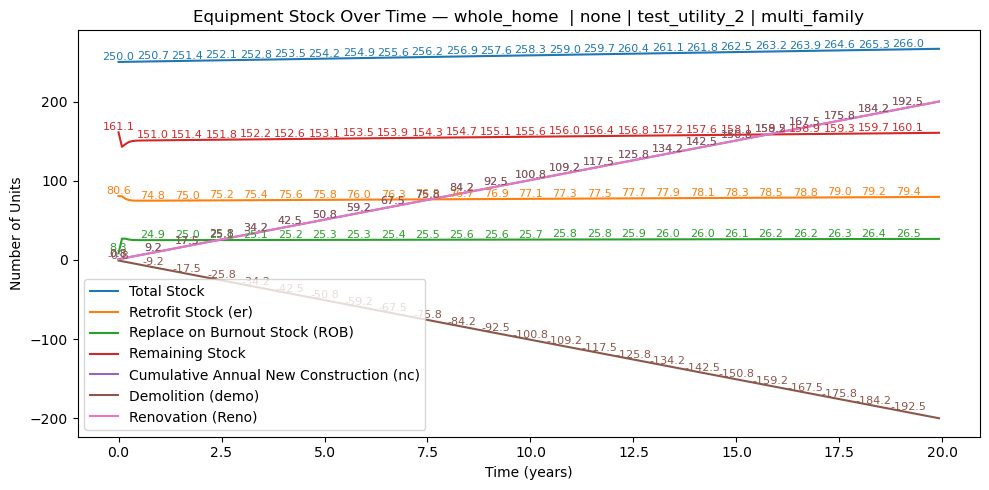

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

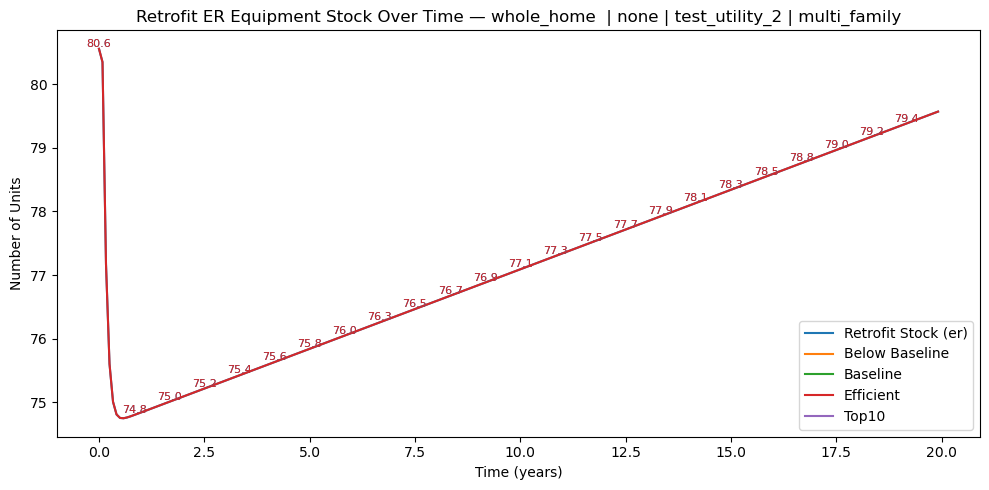

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

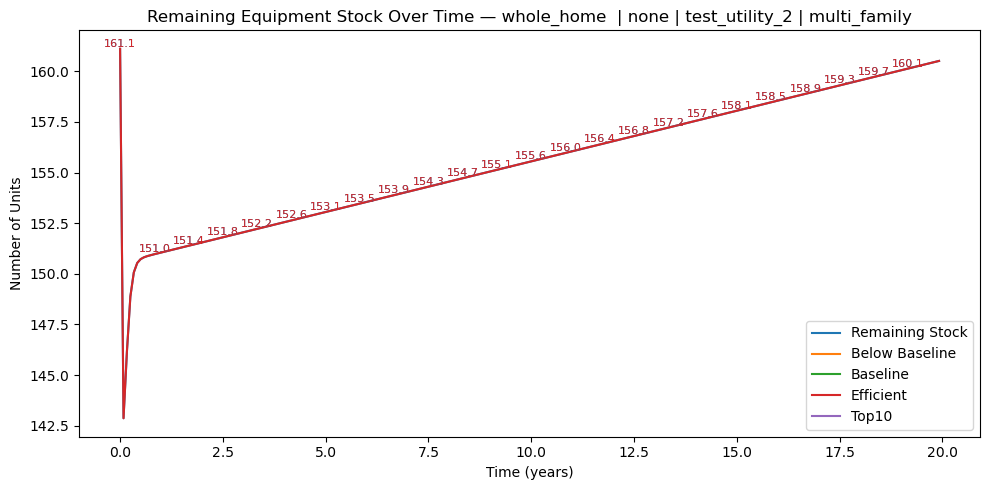

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

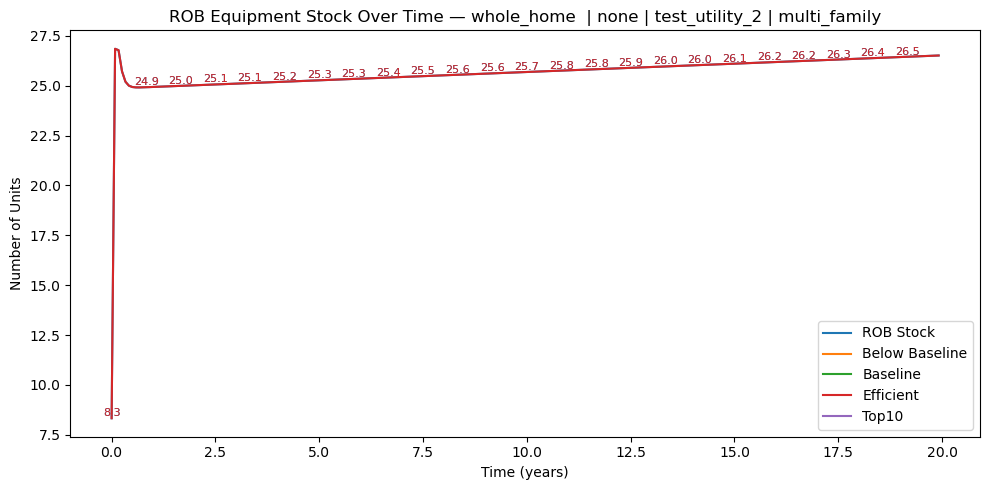

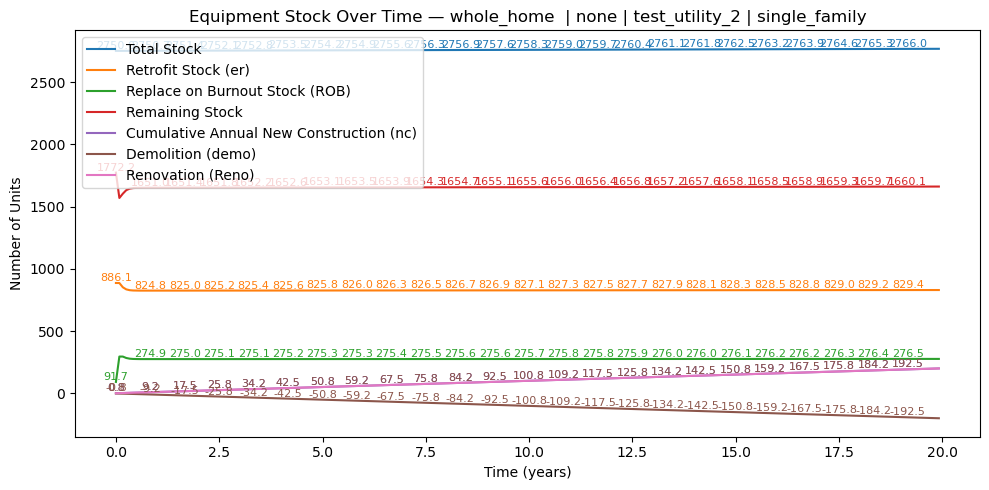

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

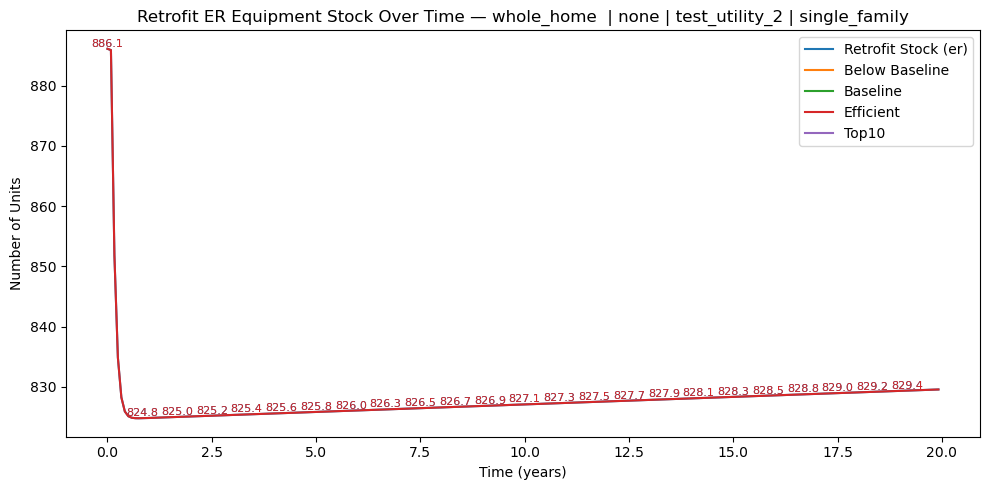

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

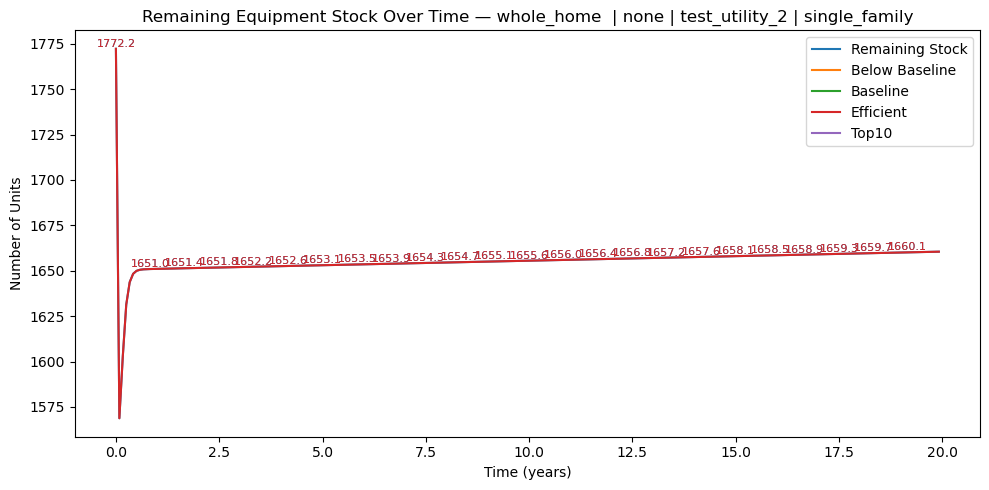

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

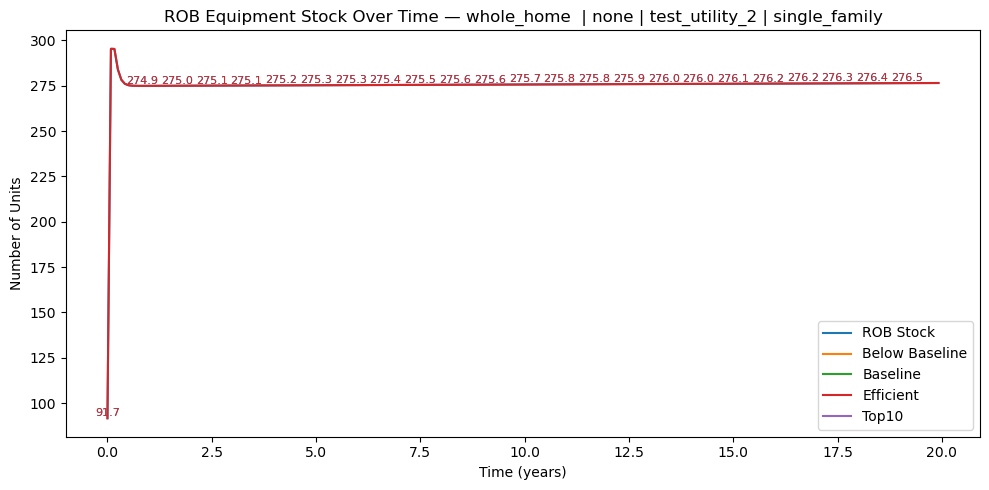

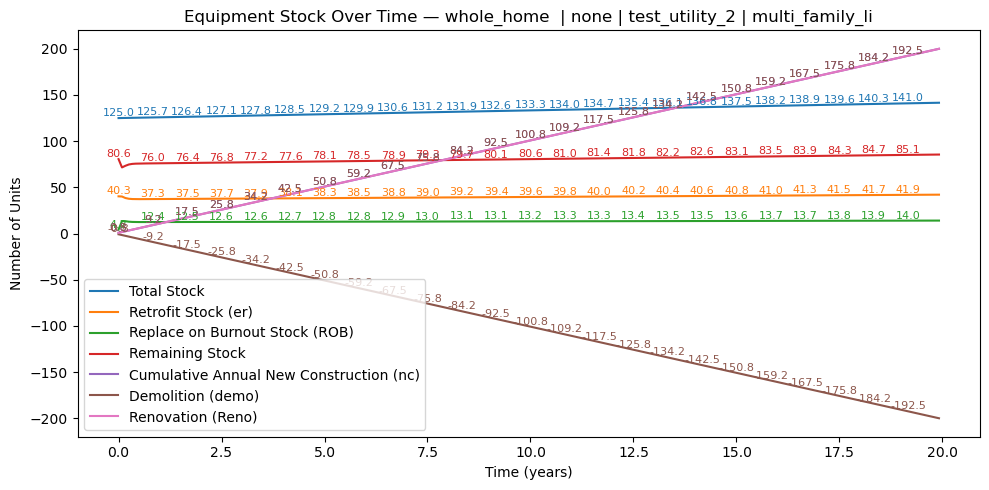

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

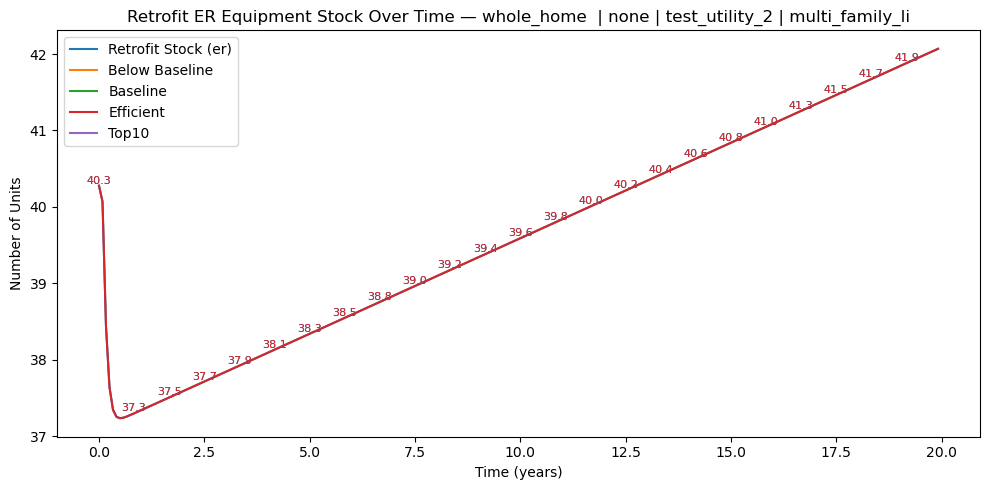

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

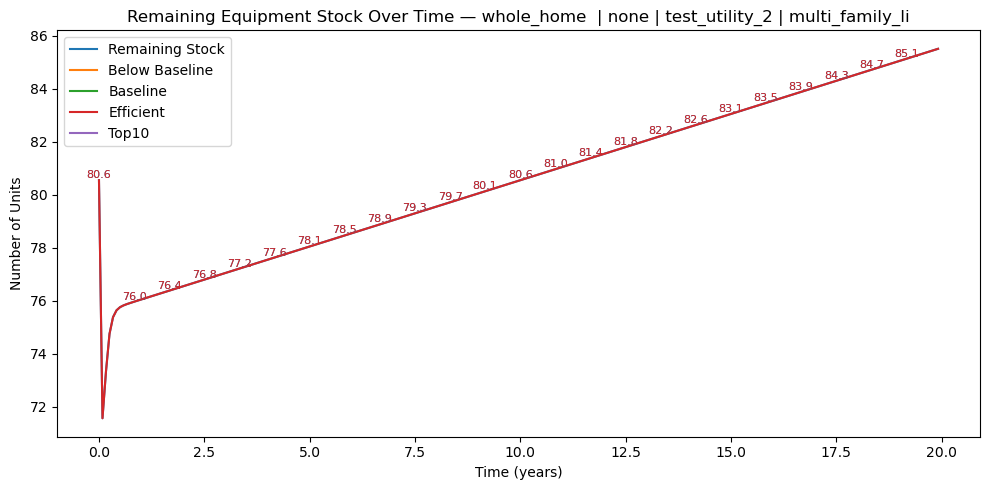

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

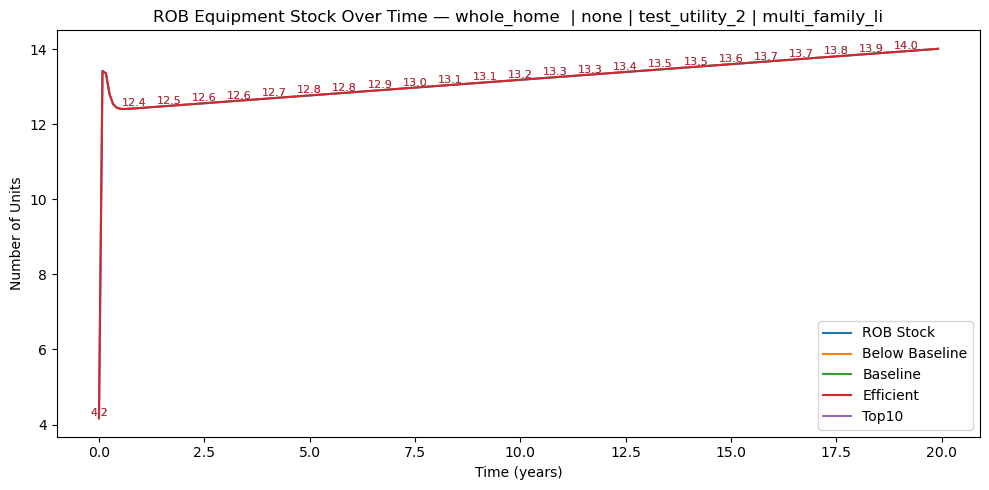

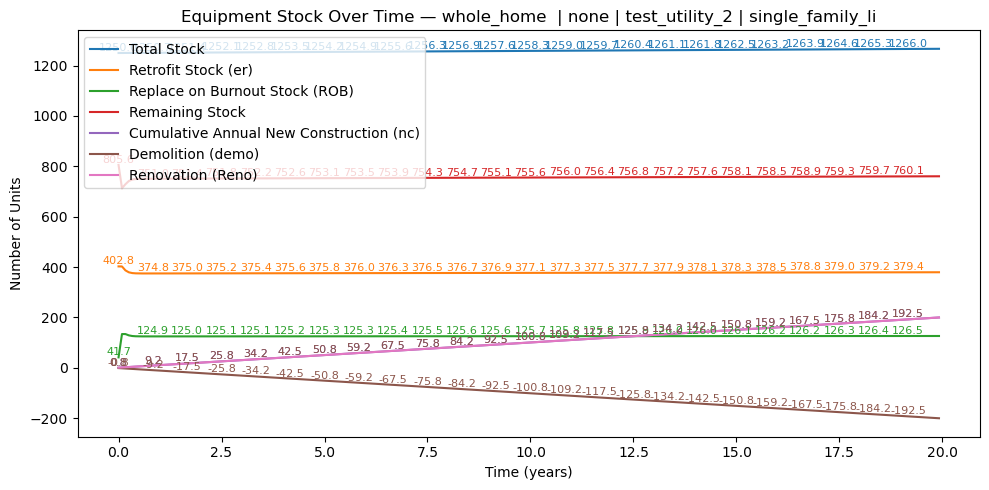

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

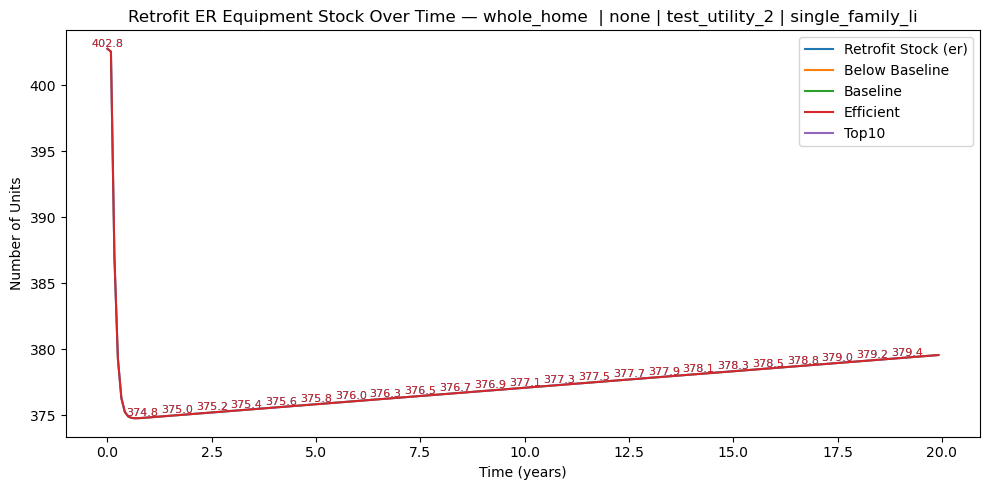

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

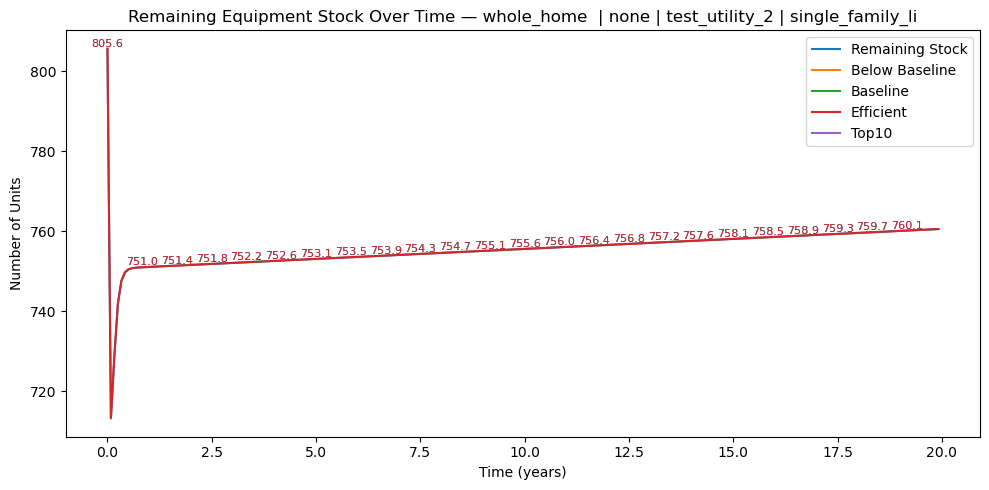

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

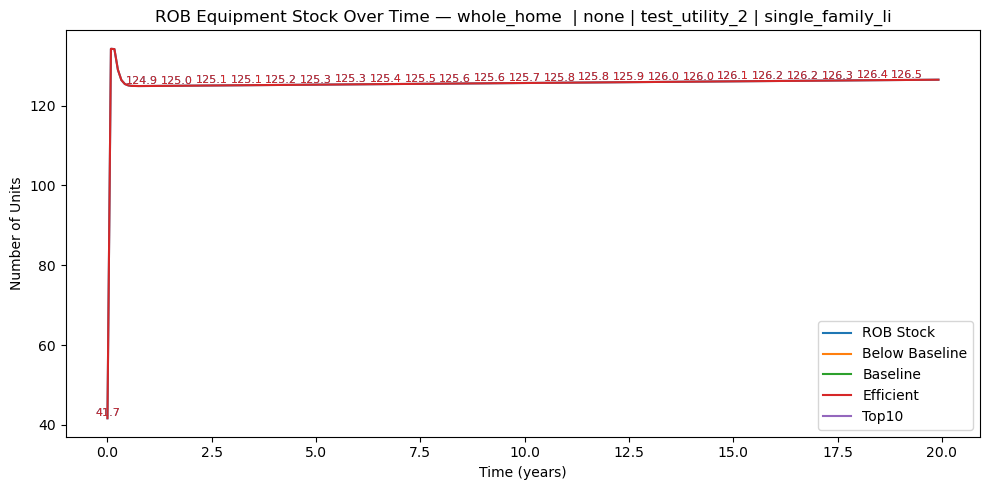

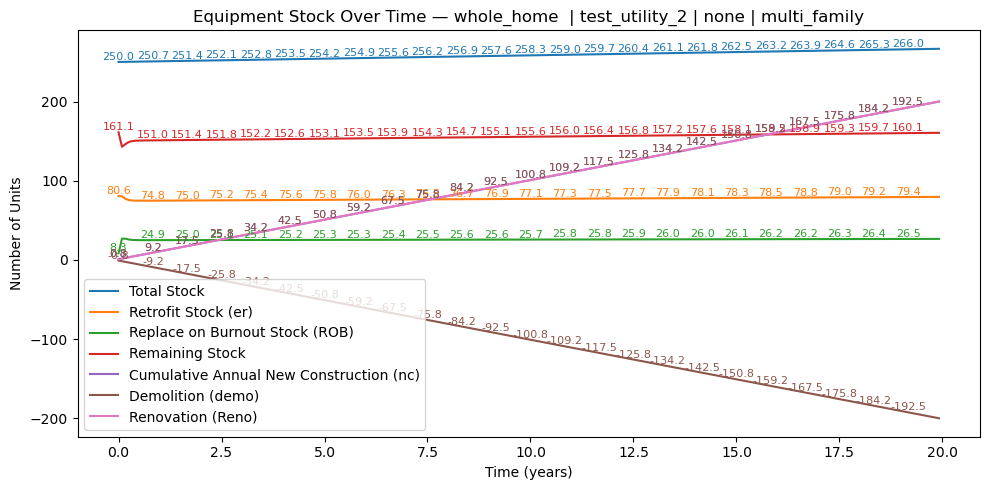

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

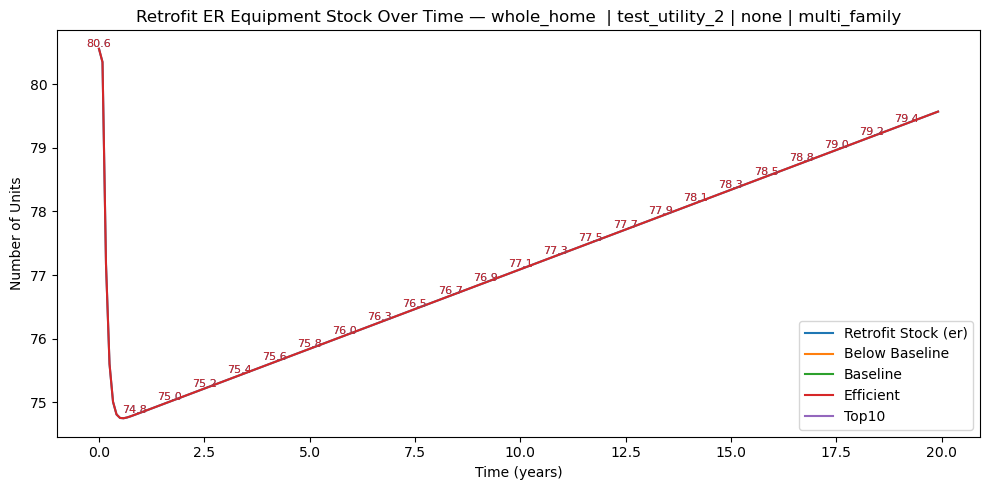

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

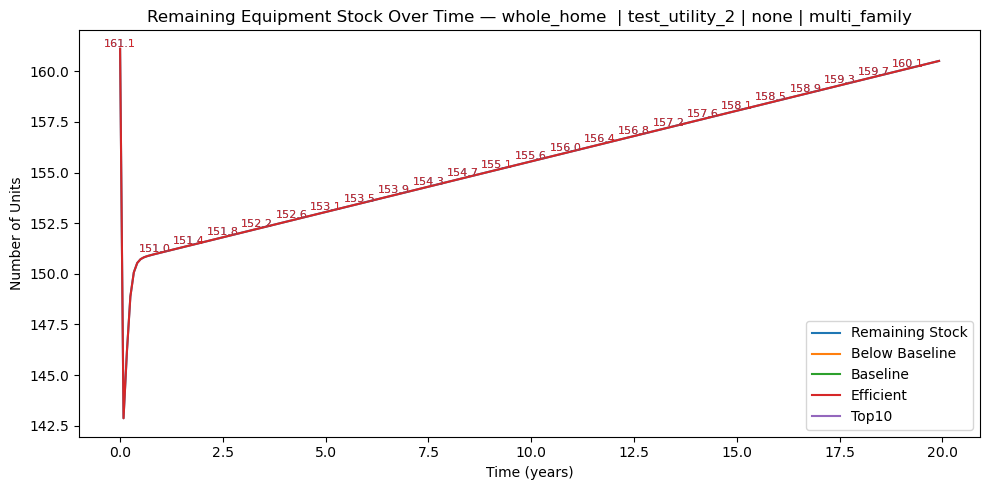

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

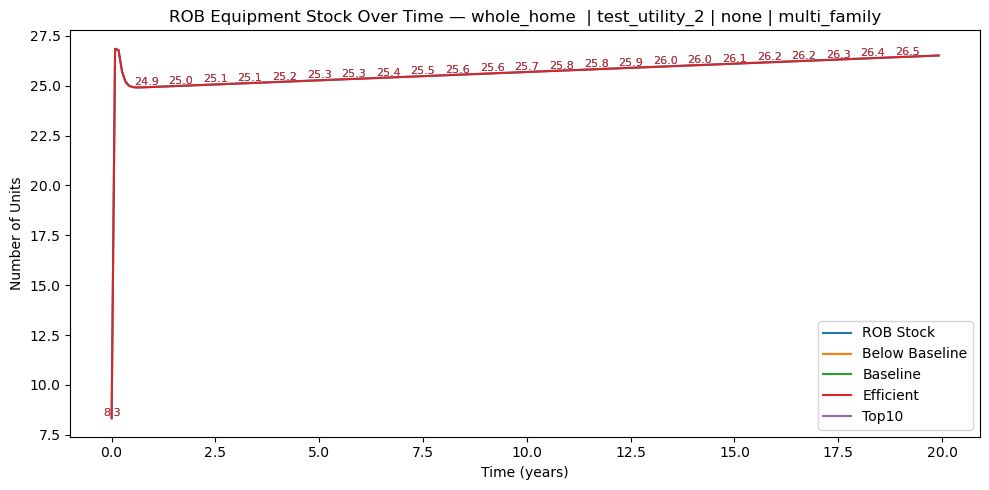

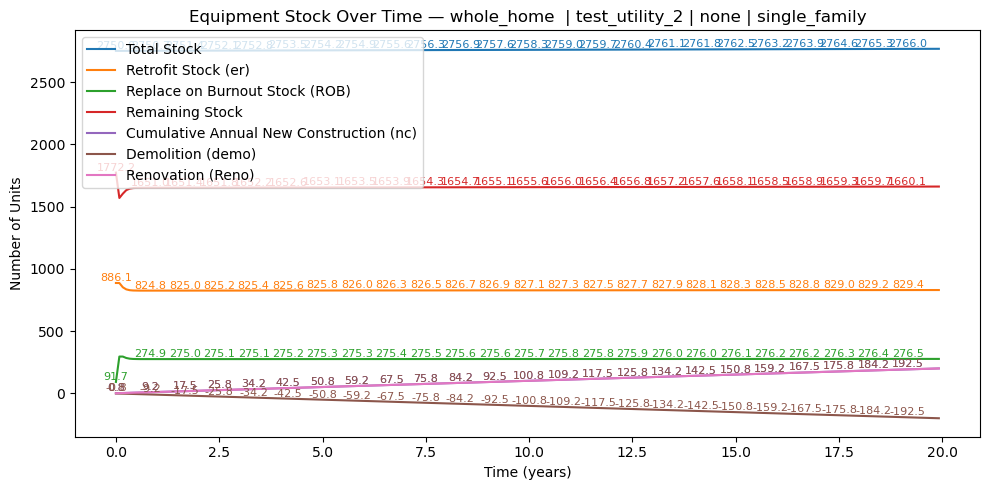

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

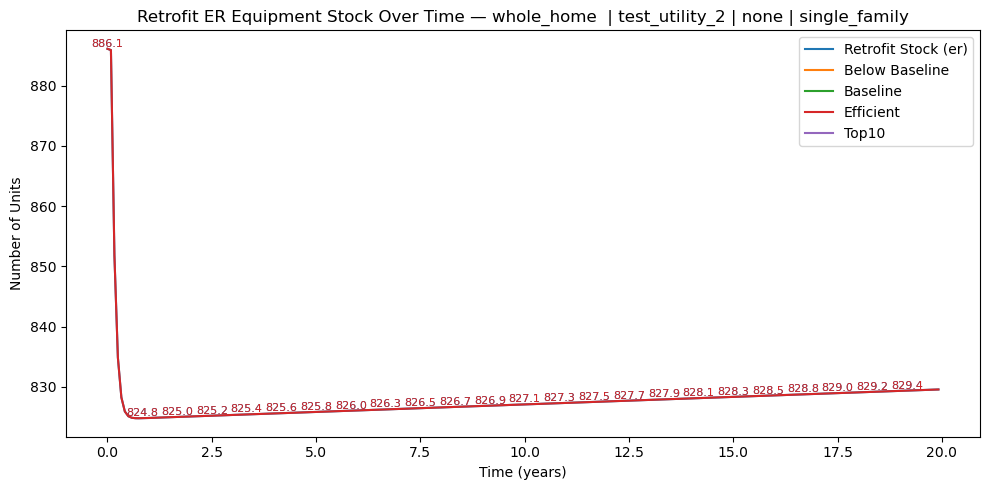

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

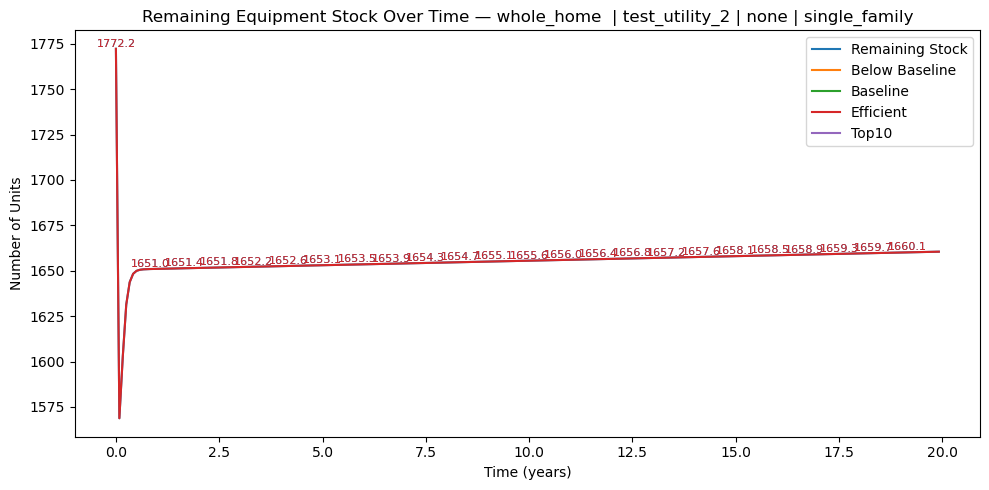

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

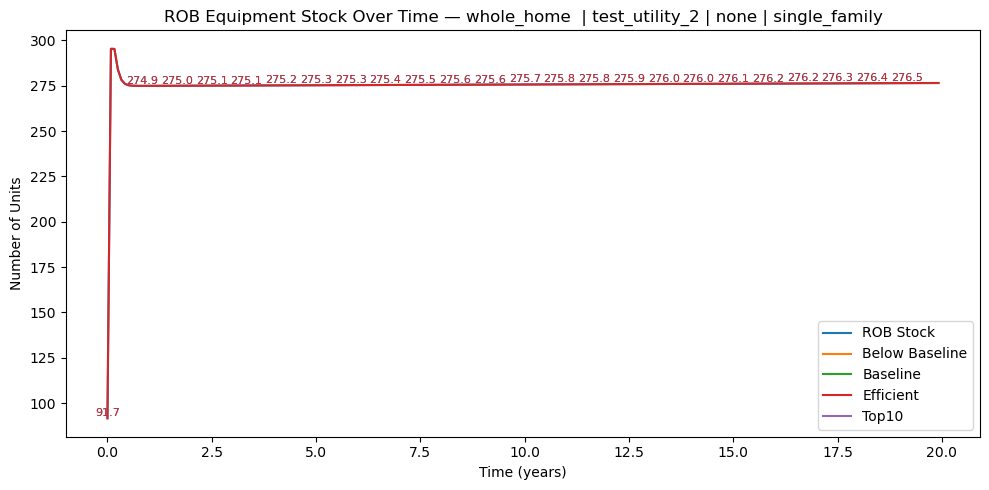

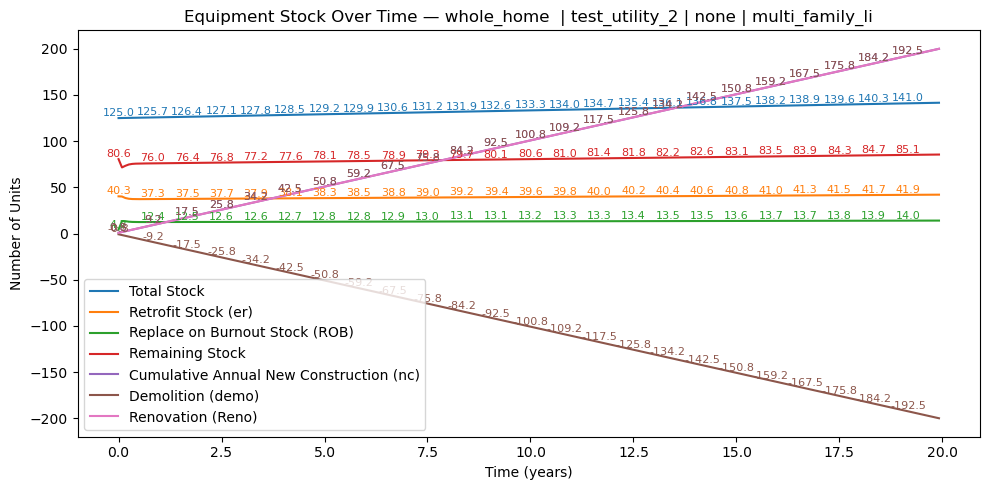

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

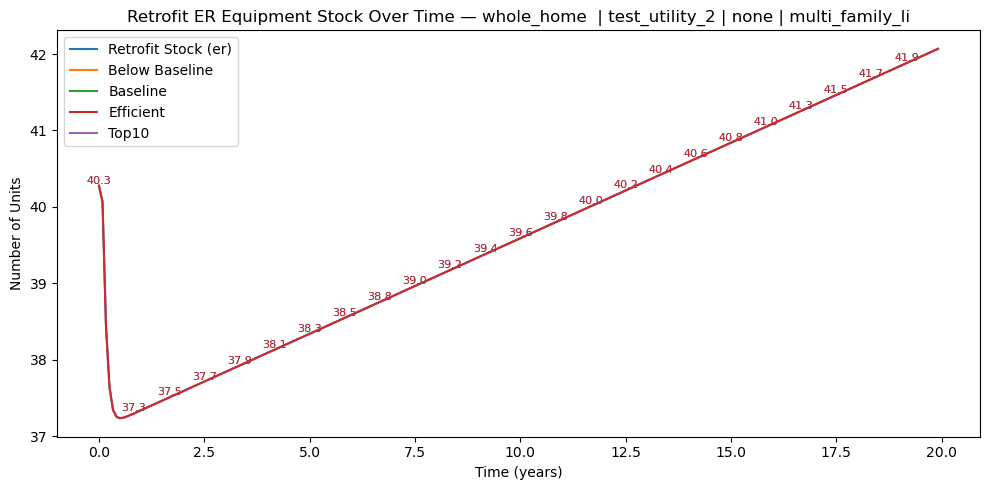

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

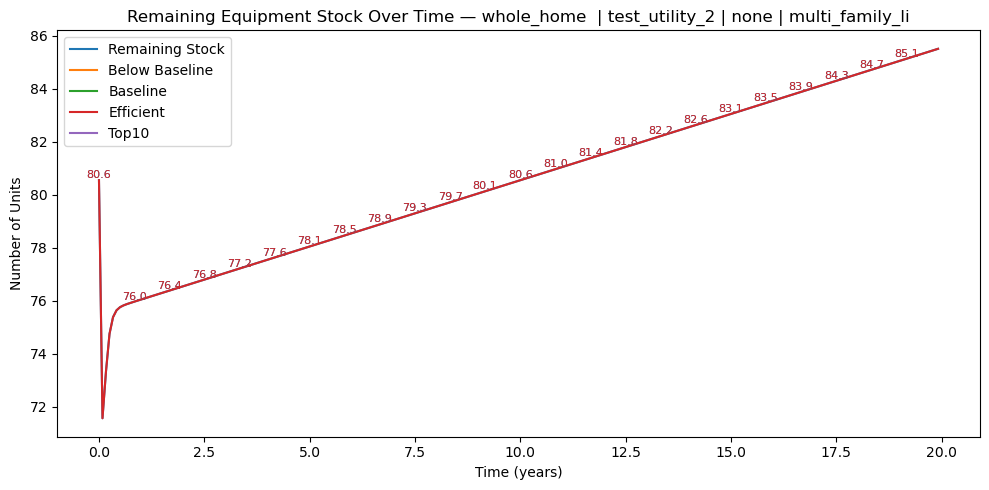

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

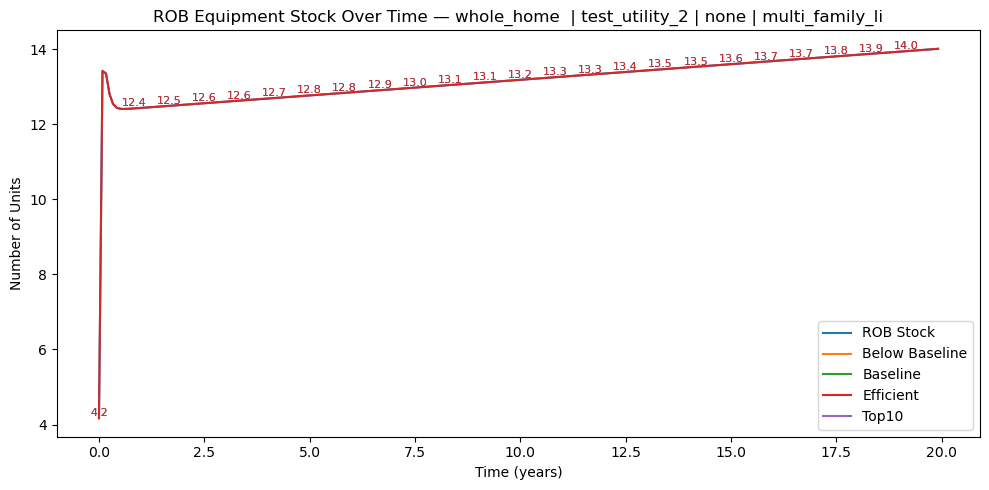

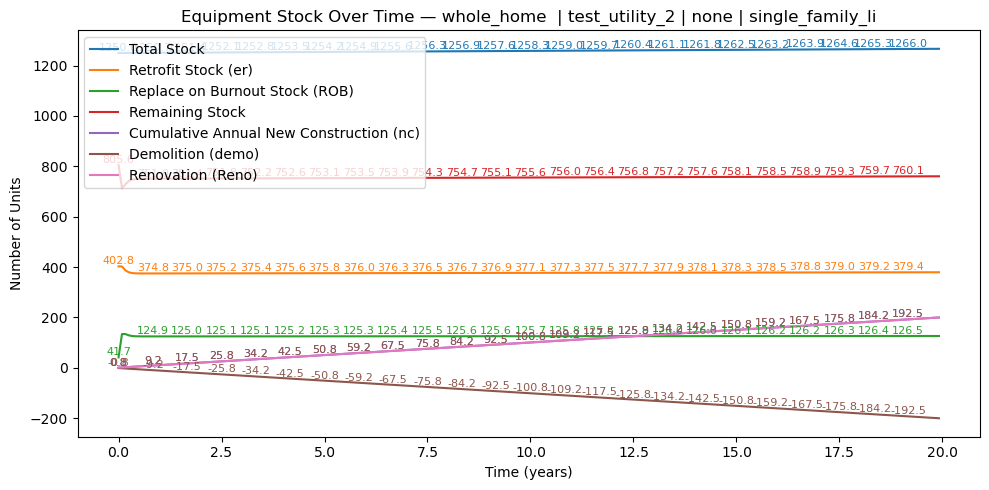

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

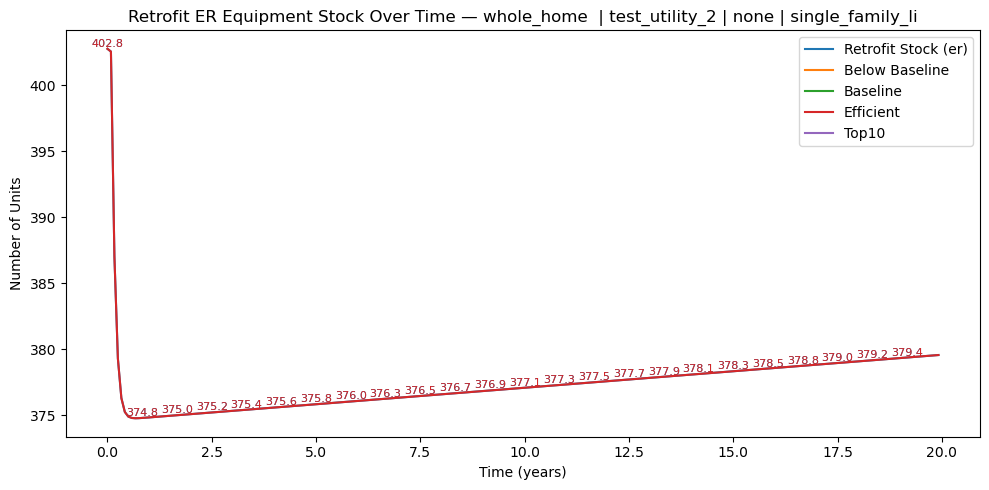

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

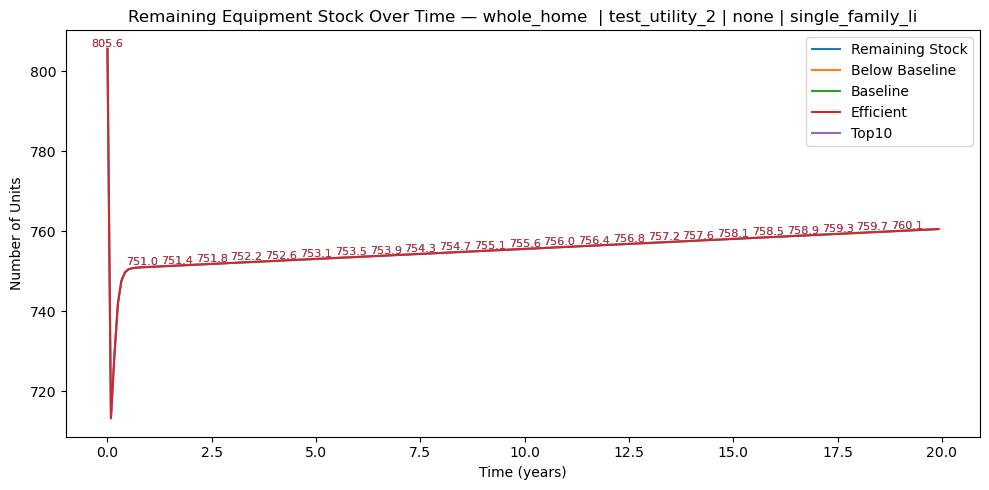

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

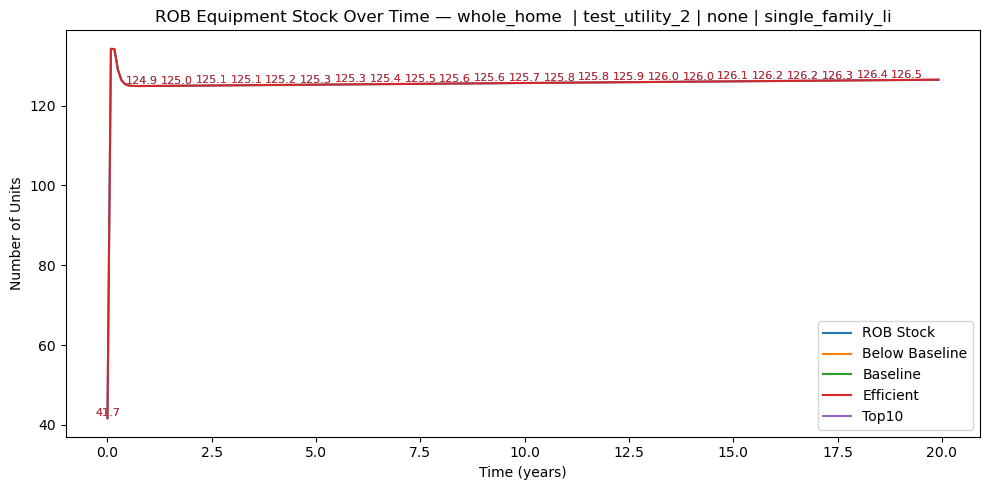

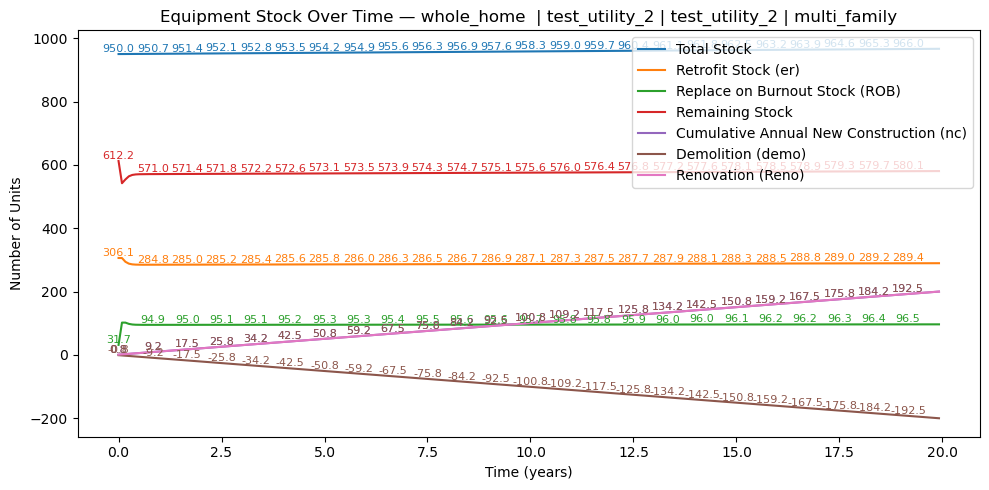

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

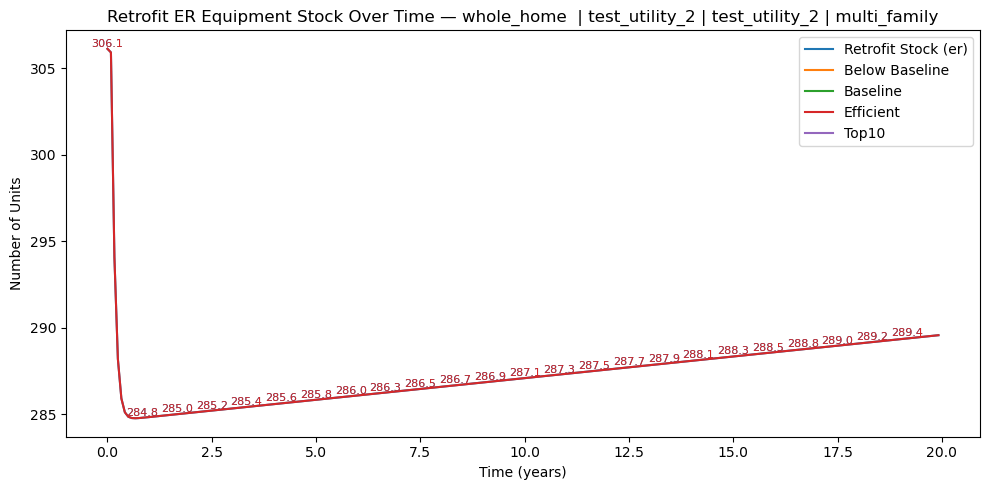

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

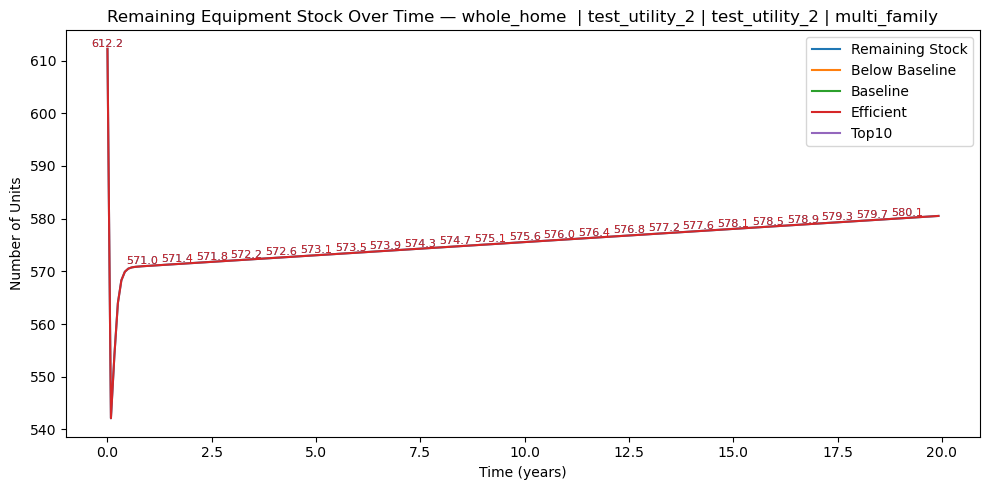

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

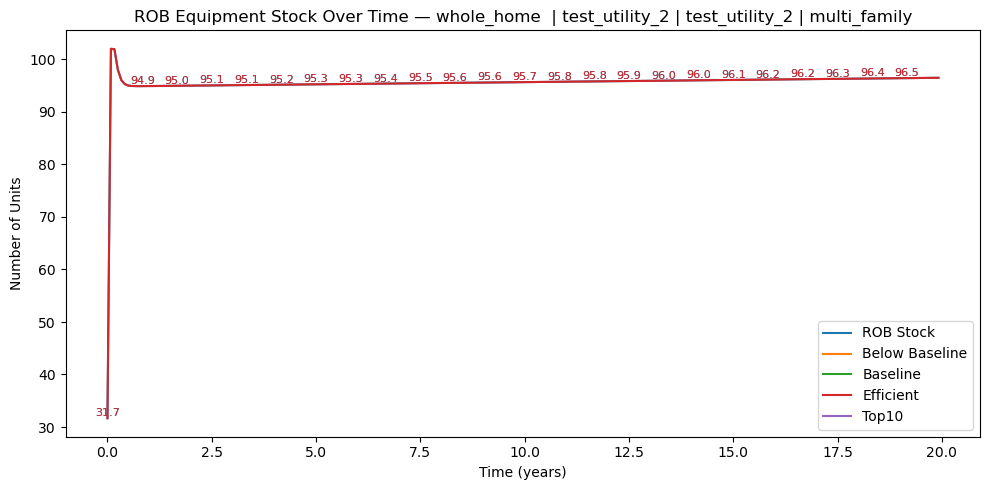

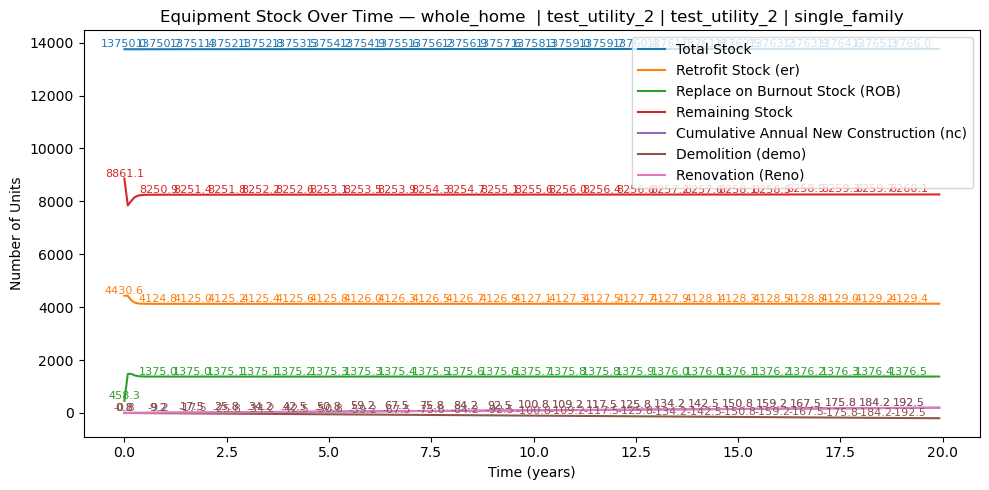

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

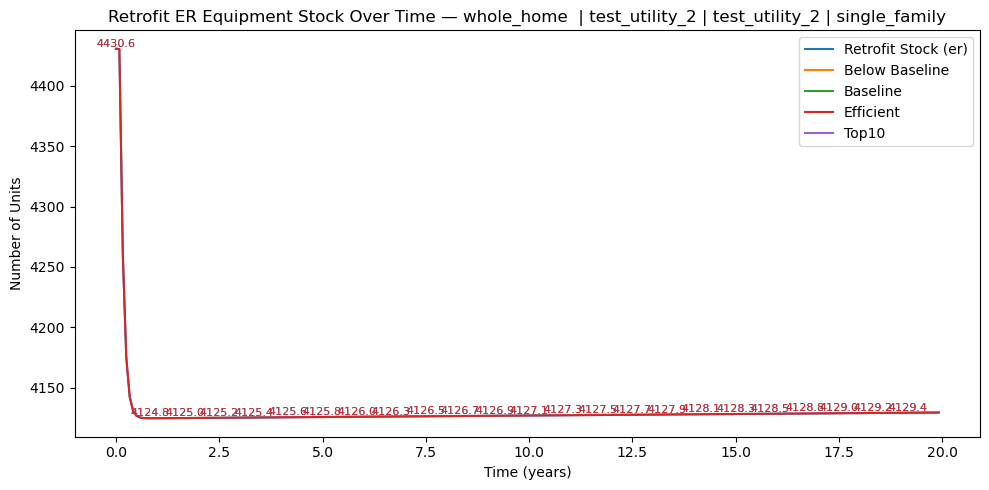

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

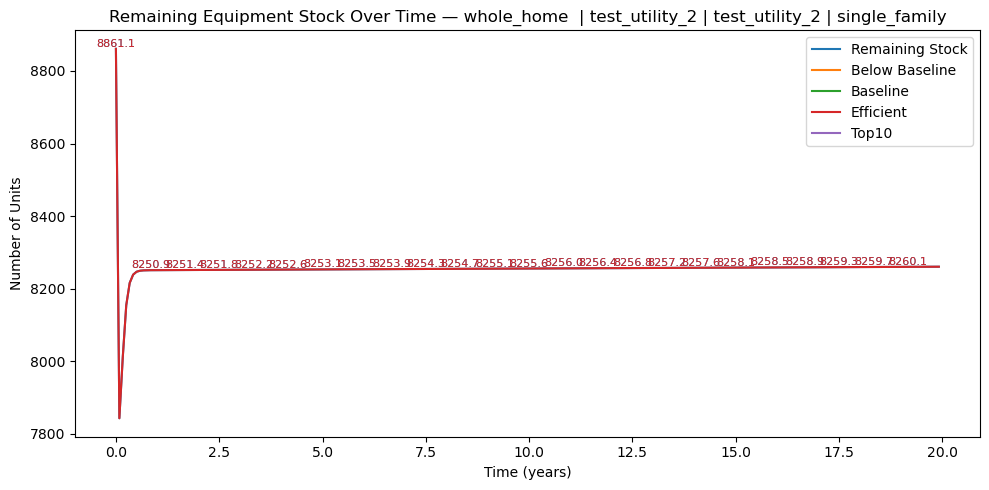

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

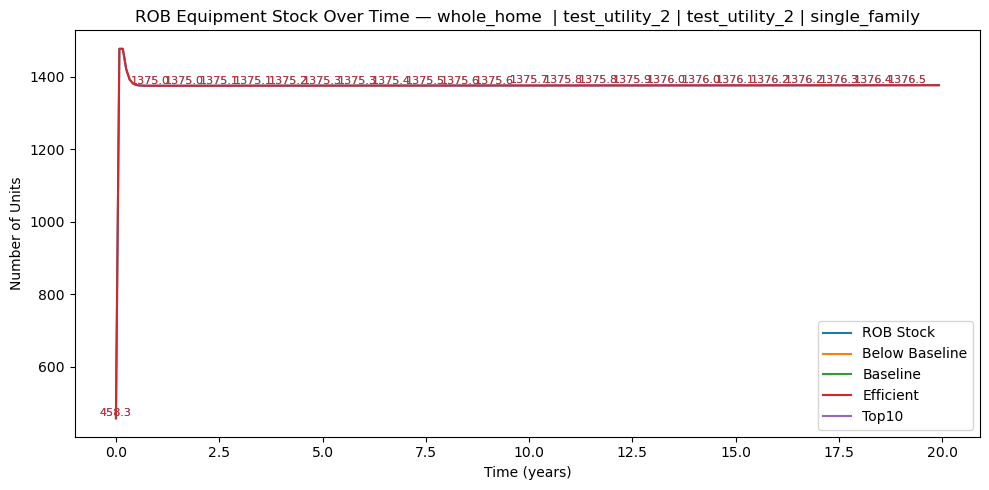

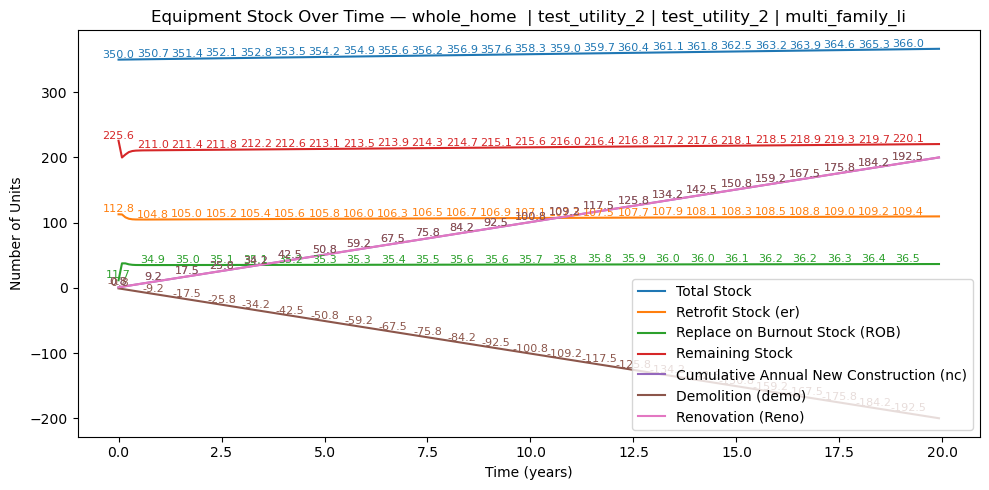

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

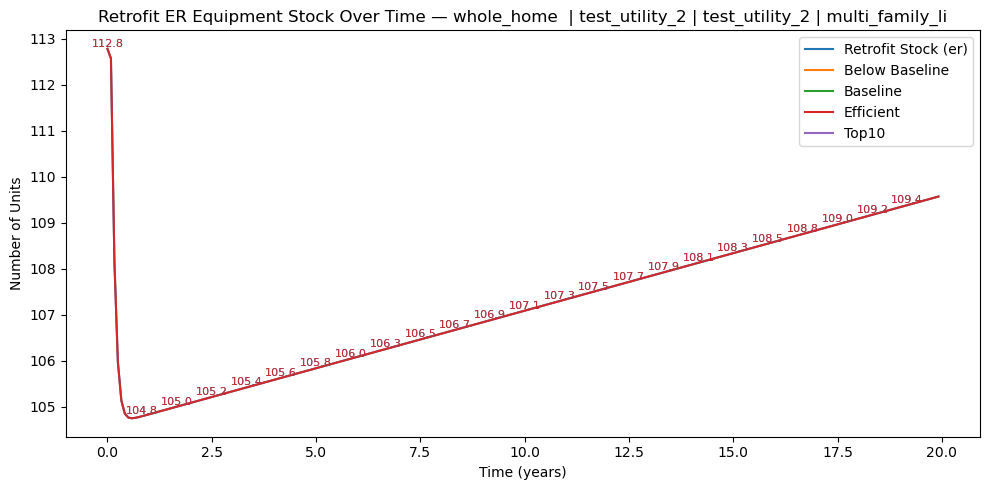

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

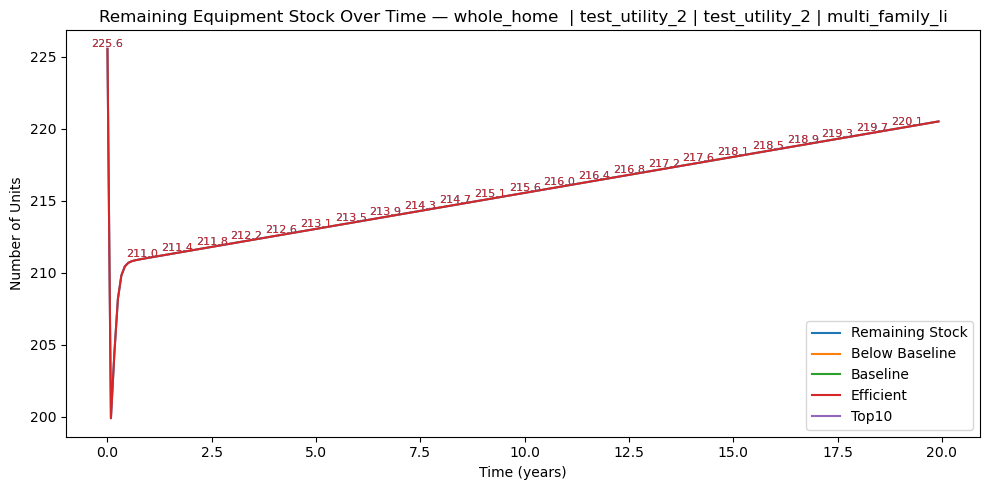

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

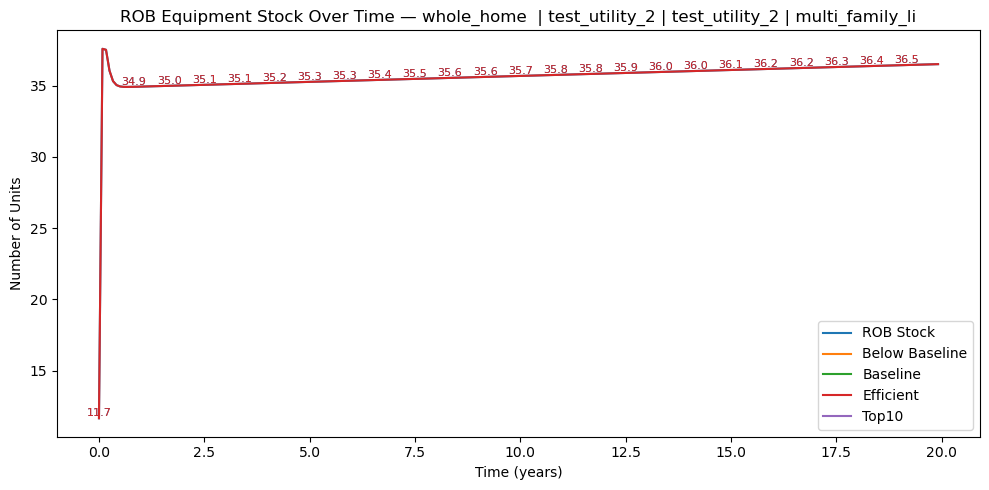

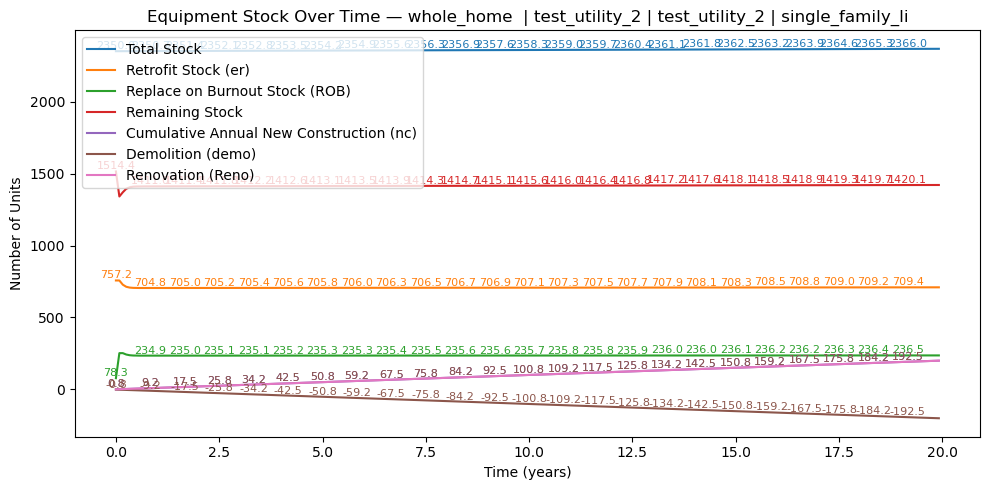

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

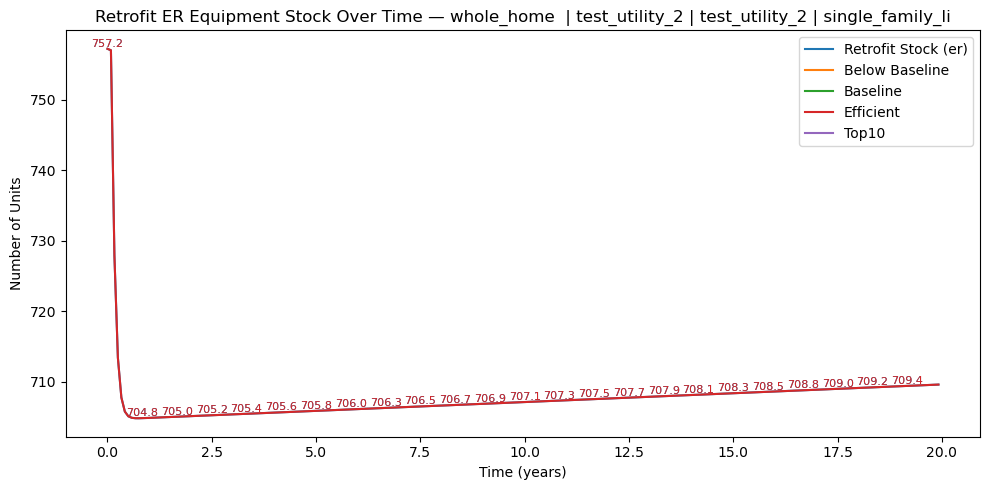

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

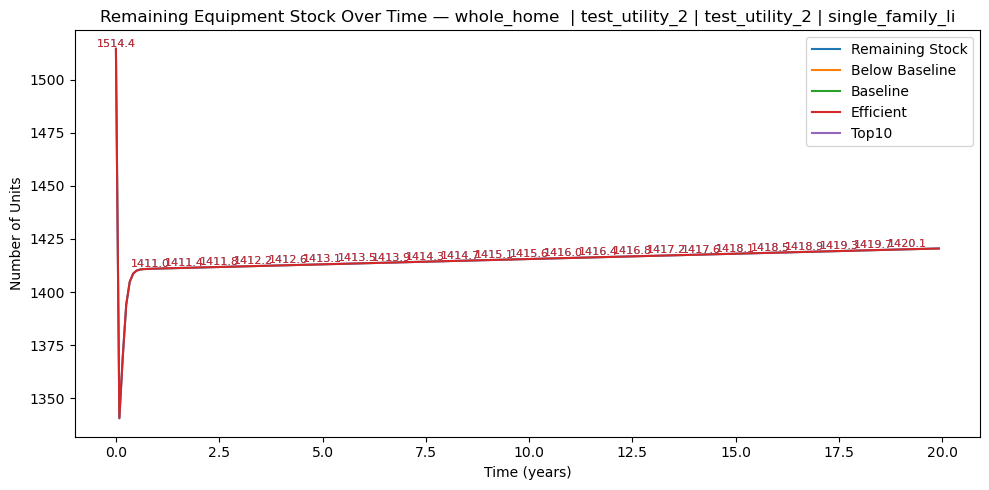

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

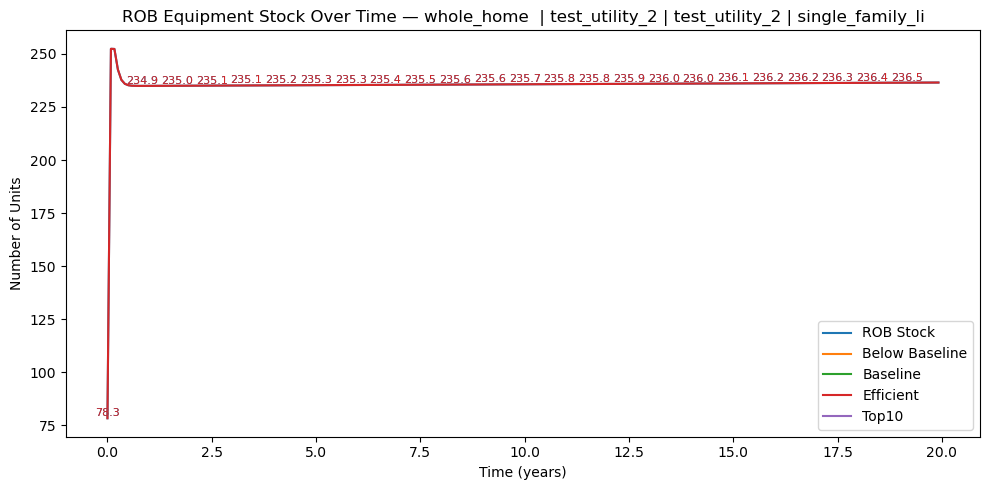

Plotted 56 group combinations.


In [16]:
# Plot results for each group combination
# import matplotlib.pyplot as plt

results_df = competition_results_df  # Change to tech_results_df to plot tech scenario

# Columns that define a group
group_cols = ['competition_group','electric_utility','gas_utility','building_type'] #'subgroup',
unique_groups = results_df[group_cols].drop_duplicates()

for _, g in unique_groups.iterrows():
    # Build mask for this group
    mask = (
        (results_df['competition_group'] == g['competition_group']) &
       # (results_df['subgroup'] == g['subgroup']) &
        (results_df['electric_utility'] == g['electric_utility']) &
        (results_df['gas_utility'] == g['gas_utility']) &
        (results_df['building_type'] == g['building_type'])
    )
    dfg = results_df[mask].sort_values('time')
    if dfg.empty:
        continue
    t = dfg['time'].values

    # Figure title suffix describing the group
    title_suffix = f"{g['competition_group']}  | {g['electric_utility']} | {g['gas_utility']} | {g['building_type']}" # | {g['subgroup']}

    # --- Plot 1: overall stocks ---
    plt.figure(figsize=(10, 5))
    plt.plot(t, dfg['total_stock'].values, label="Total Stock")
    plt.plot(t, dfg['ret_er_stock'].values, label="Retrofit Stock (er)")
    plt.plot(t, dfg['rob_stock'].values, label="Replace on Burnout Stock (ROB)")
    plt.plot(t, dfg['remaining_stock'].values, label="Remaining Stock")
    # global cumulative arrays (length n) — plot them against the same time vector
    plt.plot(time, nc_cumulative_annual, label="Cumulative Annual New Construction (nc)")
    plt.plot(time, -demo_cumulative_annual, label="Demolition (demo)")
    plt.plot(time, reno_cumulative_annual, label="Renovation (Reno)")

    # Annotate every 10 timesteps (or fewer if short)
    step = max(1, int(len(t)/20))
    for i in range(0, len(t), 10):
        plt.text(t[i], dfg['total_stock'].values[i], f"{dfg['total_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:blue')
        plt.text(t[i], dfg['ret_er_stock'].values[i], f"{dfg['ret_er_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:orange')
        plt.text(t[i], dfg['rob_stock'].values[i], f"{dfg['rob_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:green')
        plt.text(t[i], dfg['remaining_stock'].values[i], f"{dfg['remaining_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:red')
        plt.text(t[i], nc_cumulative_annual[i], f"{nc_cumulative_annual[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:purple')
        plt.text(t[i], -demo_cumulative_annual[i], f"{-demo_cumulative_annual[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:brown')
        plt.text(t[i], reno_cumulative_annual[i], f"{reno_cumulative_annual[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:brown')

    plt.xlabel("Time (years)")
    plt.ylabel("Number of Units")
    plt.title("Equipment Stock Over Time — " + title_suffix)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # --- Plot 2: Retrofit ER breakdown ---
    plt.figure(figsize=(10, 5))
    plt.plot(t, dfg['ret_er_stock'].values, label="Retrofit Stock (er)")
    plt.plot(t, dfg['ret_er_below_baseline_stock'].values, label="Below Baseline")
    plt.plot(t, dfg['ret_er_baseline_stock'].values, label="Baseline")
    plt.plot(t, dfg['ret_er_efficient_stock'].values, label="Efficient")
    plt.plot(t, dfg['ret_er_top10_stock'].values, label="Top10")
    for i in range(0, len(t), 10):
        plt.text(t[i], dfg['ret_er_stock'].values[i], f"{dfg['ret_er_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:blue')
        plt.text(t[i], dfg['ret_er_below_baseline_stock'].values[i], f"{dfg['ret_er_below_baseline_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:orange')
        plt.text(t[i], dfg['ret_er_baseline_stock'].values[i], f"{dfg['ret_er_baseline_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:green')
        plt.text(t[i], dfg['ret_er_efficient_stock'].values[i], f"{dfg['ret_er_efficient_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:red')
        plt.text(t[i], dfg['ret_er_top10_stock'].values[i], f"{dfg['ret_er_top10_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:purple')
    plt.xlabel("Time (years)")
    plt.ylabel("Number of Units")
    plt.title("Retrofit ER Equipment Stock Over Time — " + title_suffix)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # --- Plot 3: Remaining breakdown ---
    plt.figure(figsize=(10, 5))
    plt.plot(t, dfg['remaining_stock'].values, label="Remaining Stock")
    plt.plot(t, dfg['remaining_below_baseline_stock'].values, label="Below Baseline")
    plt.plot(t, dfg['remaining_baseline_stock'].values, label="Baseline")
    plt.plot(t, dfg['remaining_efficient_stock'].values, label="Efficient")
    plt.plot(t, dfg['remaining_top10_stock'].values, label="Top10")
    for i in range(0, len(t), 10):
        plt.text(t[i], dfg['remaining_stock'].values[i], f"{dfg['remaining_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:blue')
        plt.text(t[i], dfg['remaining_below_baseline_stock'].values[i], f"{dfg['remaining_below_baseline_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:orange')
        plt.text(t[i], dfg['remaining_baseline_stock'].values[i], f"{dfg['remaining_baseline_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:green')
        plt.text(t[i], dfg['remaining_efficient_stock'].values[i], f"{dfg['remaining_efficient_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:red')
        plt.text(t[i], dfg['remaining_top10_stock'].values[i], f"{dfg['remaining_top10_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:purple')
    plt.xlabel("Time (years)")
    plt.ylabel("Number of Units")
    plt.title("Remaining Equipment Stock Over Time — " + title_suffix)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # --- Plot 4: ROB breakdown ---
    plt.figure(figsize=(10, 5))
    plt.plot(t, dfg['rob_stock'].values, label="ROB Stock")
    plt.plot(t, dfg['rob_below_baseline_stock'].values, label="Below Baseline")
    plt.plot(t, dfg['rob_baseline_stock'].values, label="Baseline")
    plt.plot(t, dfg['rob_efficient_stock'].values, label="Efficient")
    plt.plot(t, dfg['rob_top10_stock'].values, label="Top10")
    for i in range(0, len(t), 10):
        plt.text(t[i], dfg['rob_stock'].values[i], f"{dfg['rob_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:blue')
        plt.text(t[i], dfg['rob_below_baseline_stock'].values[i], f"{dfg['rob_below_baseline_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:orange')
        plt.text(t[i], dfg['rob_baseline_stock'].values[i], f"{dfg['rob_baseline_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:green')
        plt.text(t[i], dfg['rob_efficient_stock'].values[i], f"{dfg['rob_efficient_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:red')
        plt.text(t[i], dfg['rob_top10_stock'].values[i], f"{dfg['rob_top10_stock'].values[i]:.1f}", fontsize=8, ha='center', va='bottom', color='tab:purple')
    plt.xlabel("Time (years)")
    plt.ylabel("Number of Units")
    plt.title("ROB Equipment Stock Over Time — " + title_suffix)
    plt.legend()
    plt.tight_layout()
    plt.show()



# Done plotting all groups
print(f"Plotted {len(unique_groups)} group combinations.")